In [1]:
import pandas as pd 
import numpy as np
import seaborn as sns 
import matplotlib.pyplot as plt 
import klib
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, classification_report



In [2]:
!pip install -q klib

In [3]:

df=pd.read_csv('Indian_Liver_Patient_Dataset.csv')

In [4]:
df.head(5)

,Age,Gender,TB,DB,Alkphos,Sgpt,Sgot,TP,ALB,A/G Ratio,Selector
0,65,Female,0.7,0.1,187,16,18,6.8,3.3,0.90,1
1,62,Male,10.9,5.5,699,64,100,7.5,3.2,0.74,1
2,62,Male,7.3,4.1,490,60,68,7.0,3.3,0.89,1
3,58,Male,1.0,0.4,182,14,20,6.8,3.4,1.00,1
4,72,Male,3.9,2.0,195,27,59,7.3,2.4,0.40,1


In [5]:
from sklearn.preprocessing import LabelEncoder

# Assuming df is your DataFrame, and 'Gender' is a categorical column
label_encoder = LabelEncoder()
df['Gender_encoded'] = label_encoder.fit_transform(df['Gender'])
# Male =1 and Female =0
df.drop(['Gender'], axis=1, inplace=True)


In [6]:
df.head(5)

,Age,TB,DB,Alkphos,Sgpt,Sgot,TP,ALB,A/G Ratio,Selector,Gender_encoded
0,65,0.7,0.1,187,16,18,6.8,3.3,0.90,1,0
1,62,10.9,5.5,699,64,100,7.5,3.2,0.74,1,1
2,62,7.3,4.1,490,60,68,7.0,3.3,0.89,1,1
3,58,1.0,0.4,182,14,20,6.8,3.4,1.00,1,1
4,72,3.9,2.0,195,27,59,7.3,2.4,0.40,1,1


In [7]:
df['Selector']=df['Selector'].map({1: 1, 2: 0})

In [8]:
df['Selector'].value_counts()

1    416
0    167
Name: Selector, dtype: int64

In [9]:
df.isnull().sum()

Age               0
TB                0
DB                0
Alkphos           0
Sgpt              0
Sgot              0
TP                0
ALB               0
A/G Ratio         4
Selector          0
Gender_encoded    0
dtype: int64

In [10]:
df.describe()

,Age,TB,DB,Alkphos,Sgpt,Sgot,TP,ALB,A/G Ratio,Selector,Gender_encoded
count,583.000000,583.000000,583.000000,583.000000,583.000000,583.000000,583.000000,583.000000,579.000000,583.000000,583.000000
mean,44.746141,3.298799,1.486106,290.576329,80.713551,109.910806,6.483190,3.141852,0.947064,0.713551,0.756432
std,16.189833,6.209522,2.808498,242.937989,182.620356,288.918529,1.085451,0.795519,0.319592,0.452490,0.429603
min,4.000000,0.400000,0.100000,63.000000,10.000000,10.000000,2.700000,0.900000,0.300000,0.000000,0.000000
25%,33.000000,0.800000,0.200000,175.500000,23.000000,25.000000,5.800000,2.600000,0.700000,0.000000,1.000000
50%,45.000000,1.000000,0.300000,208.000000,35.000000,42.000000,6.600000,3.100000,0.930000,1.000000,1.000000
75%,58.000000,2.600000,1.300000,298.000000,60.500000,87.000000,7.200000,3.800000,1.100000,1.000000,1.000000
max,90.000000,75.000000,19.700000,2110.000000,2000.000000,4929.000000,9.600000,5.500000,2.800000,1.000000,1.000000


In [11]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 583 entries, 0 to 582
Data columns (total 11 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   Age             583 non-null    int64  
 1   TB              583 non-null    float64
 2   DB              583 non-null    float64
 3   Alkphos         583 non-null    int64  
 4   Sgpt            583 non-null    int64  
 5   Sgot            583 non-null    int64  
 6   TP              583 non-null    float64
 7   ALB             583 non-null    float64
 8   A/G Ratio       579 non-null    float64
 9   Selector        583 non-null    int64  
 10  Gender_encoded  583 non-null    int64  
dtypes: float64(5), int64(6)
memory usage: 50.2 KB


In [12]:
df['Selector'].value_counts()
#Here 1 means liver patient and 2 denote as Non-Liver Patient 

1    416
0    167
Name: Selector, dtype: int64

<Axes: >

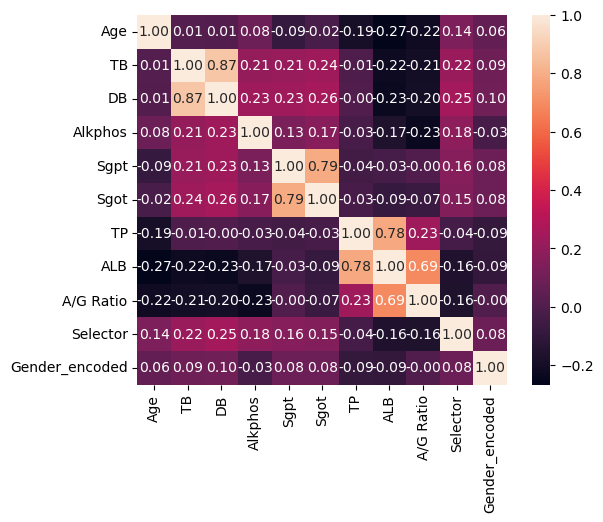

In [13]:
corr=df.corr(numeric_only=True)

sns.heatmap(corr, cbar = True, square = True, annot=True, fmt= '.2f', annot_kws={'size': 10})


The updated correlation matrix, with the new column names, is now displayed. The heatmap visually represents the correlation coefficients between different pairs of features. Key observations from the matrix include:

1. **TB (Total Bilirubin) and DB (Direct Bilirubin)**: Show a very strong positive correlation of 0.87.

2. **Sgpt (Alamine Aminotransferase) and Sgot (Aspartate Aminotransferase)**: Also exhibit a strong positive correlation of 0.79.

3. **TP (Total Proteins) and ALB (Albumin)**: Have a strong positive correlation of 0.78.

4. **ALB (Albumin) and A/G Ratio (Albumin and Globulin Ratio)**: Show a strong positive correlation of 0.69.

5. **Correlations with Selector Variable**: There are negative correlations with DB (-0.25), TB (-0.22), and Alkphos (-0.18), and positive correlations with ALB (0.16) and A/G Ratio (0.16).

The heatmap and the correlation coefficients provide a comprehensive overview of how each feature relates to the others in the dataset. If you have any specific questions or need further analysis, feel free to ask!

In [14]:
select_col=['TB','DB','Sgpt','Sgot','ALB','A/G Ratio']    

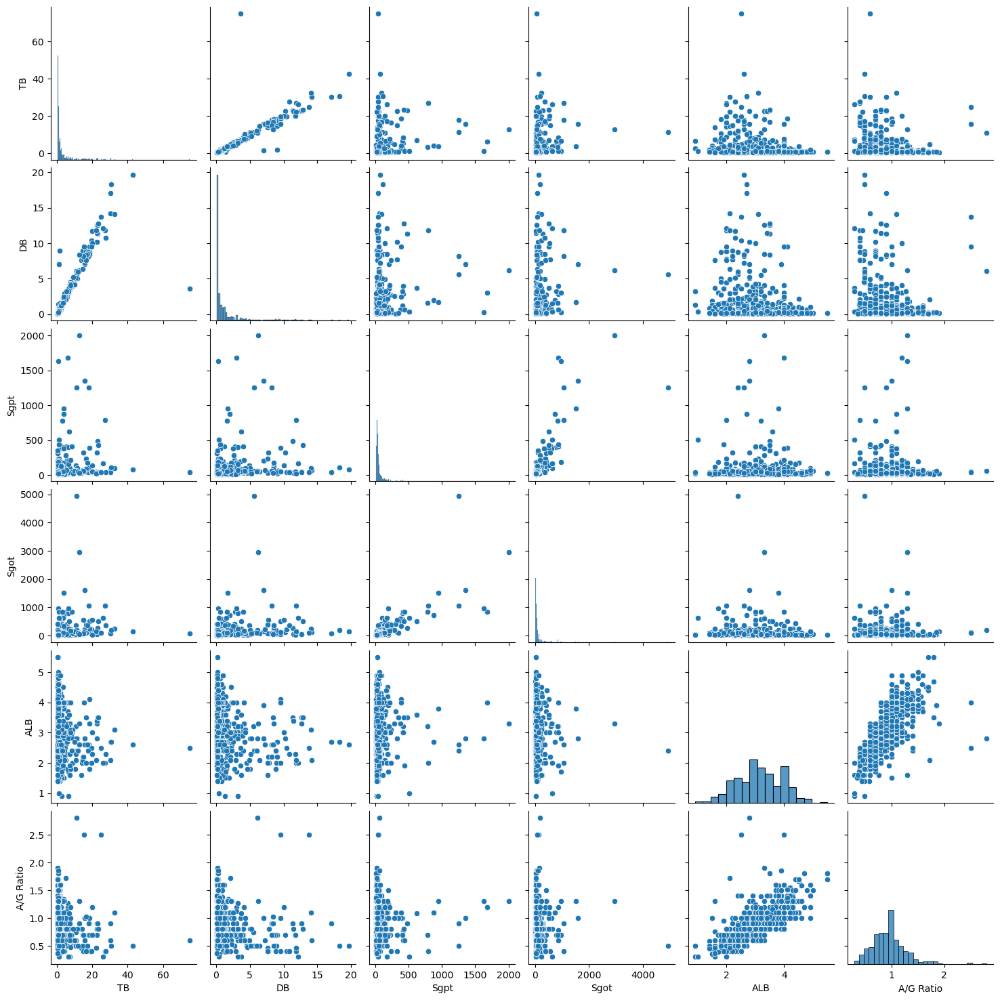

In [15]:
g = sns.pairplot(df[select_col])

In [16]:
df.columns

Index(['Age', 'TB', 'DB', 'Alkphos', 'Sgpt', 'Sgot', 'TP', 'ALB', 'A/G Ratio',
       'Selector', 'Gender_encoded'],
      dtype='object')

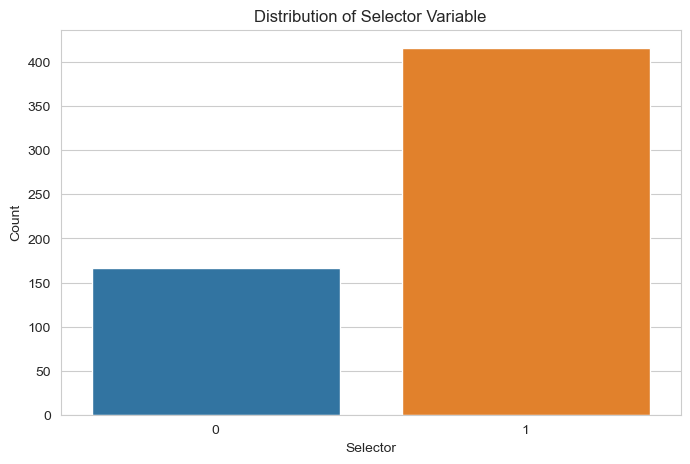

1    0.713551
0    0.286449
Name: Selector, dtype: float64

In [17]:
# Setting the aesthetic style of the plots
sns.set_style("whitegrid")

# Distribution of the 'Selector' variable
plt.figure(figsize=(8, 5))
sns.countplot(x='Selector', data=df)
plt.title('Distribution of Selector Variable')
plt.xlabel('Selector')
plt.ylabel('Count')
plt.show()

# Checking the balance of the 'Selector' variable
selector_balance = df['Selector'].value_counts(normalize=True)
selector_balance

The distribution of the 'Selector' variable shows that it is somewhat imbalanced. About 71.36% of the entries are labeled as '1', and 28.64% are labeled as '2'. This imbalance could be important, especially if the dataset is used for predictive modeling, as it might affect the model's performance.

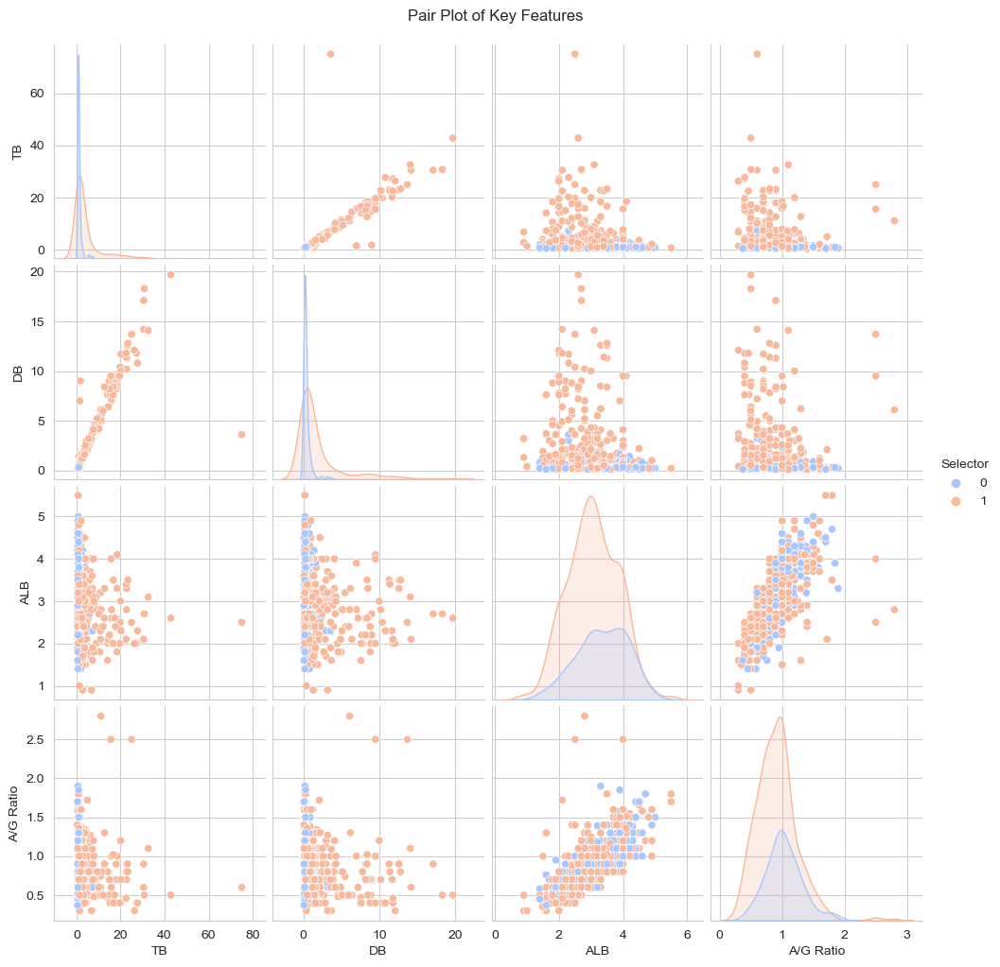

In [18]:
# Pair Plot for a subset of features
subset_features = ['TB', 'DB', 'ALB', 'A/G Ratio', 'Selector']
pair_plot_data = df[subset_features]

sns.pairplot(pair_plot_data, hue='Selector', palette='coolwarm')
plt.suptitle('Pair Plot of Key Features', y=1.02)  # Adjust title position
plt.show()



The pair plot provides a comprehensive view of the pairwise relationships and distributions of key features, colored by the 'Selector' variable:

Scatter Plots: These plots show the relationship between each pair of features. The distribution of points can give insights into correlations and potential clusters.
Diagonal Plots: These are the distributions of each individual feature. They give an idea of the spread and skewness of the data.
Hue (Selector): The different colors represent the different values of the 'Selector' variable, allowing us to see how these values are distributed across the feature combinations.
Next, let's create violin plots for a deeper look at the distribution of these features across the different values of the 'Selector' variable.

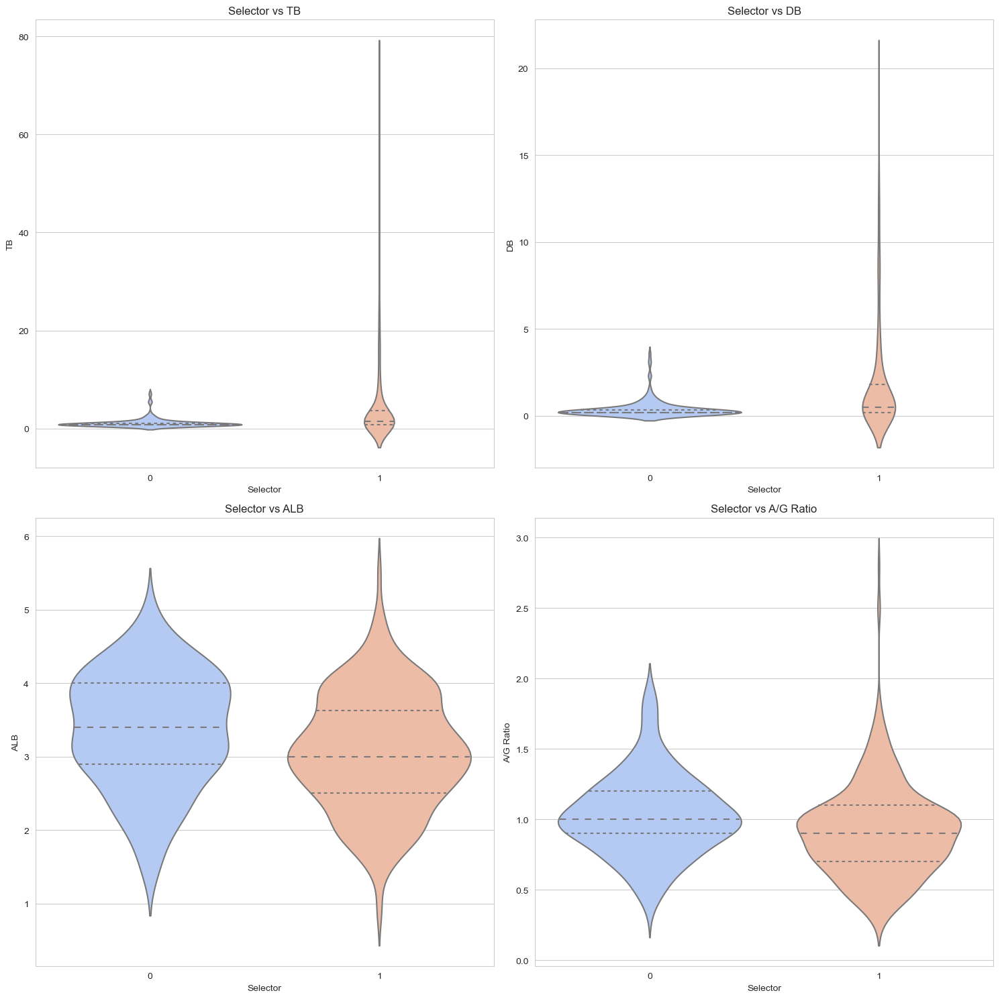

In [19]:
# Creating violin plots for key features against the 'Selector' variable
fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(15, 15))
axes = axes.flatten()

# Plotting violin plots for each feature
for i, feature in enumerate(subset_features[:-1]):  # Exclude 'Selector' itself
    sns.violinplot(x='Selector', y=feature, data=df, ax=axes[i], palette='coolwarm', inner='quartile')
    axes[i].set_title(f'Selector vs {feature}')
    axes[i].set_xlabel('Selector')
    axes[i].set_ylabel(feature)

plt.tight_layout()
plt.show()


The violin plots provide an in-depth view of the distribution of key features across the different values of the 'Selector' variable:

Total Bilirubin (TB) and Direct Bilirubin (DB): These plots show the density and range of values for each category of the Selector. Notice the wider sections of the violin plot indicate a higher density of data points.
Albumin (ALB) and A/G Ratio: The distribution shapes are distinct between the two Selector categories, indicating differences in these biochemical parameters across the categories.
Overall Observations: These plots combine the features of box plots with a kernel density estimation. The inner 'quartile' lines provide a summary similar to a box plot, while the outer shape represents the density estimate.
For the final part of the deep dive, let's create a Facet Grid for one of the features. This will allow us to examine the distribution of a single feature across the categories of the Selector variable in more detail. I'll focus on "Albumin" (ALB) as an example. Let's create a Facet Grid with histograms for each category of the Selector.

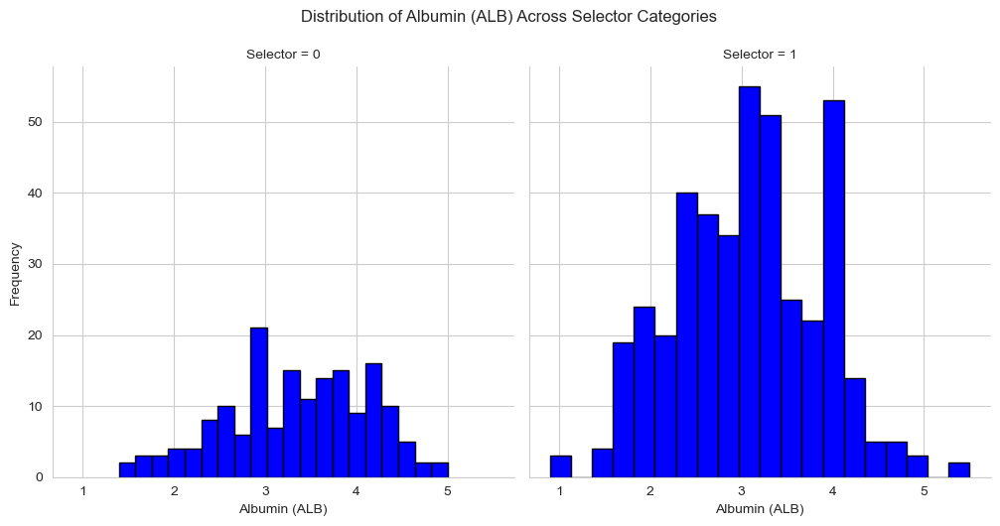

In [20]:
# Creating a Facet Grid for the 'ALB' feature
g = sns.FacetGrid(df, col='Selector', height=5, aspect=1)
g = g.map(plt.hist, 'ALB', bins=20, color='b', edgecolor='k')

# Adding titles and labels
g.fig.suptitle('Distribution of Albumin (ALB) Across Selector Categories', y=1.05)
g.set_axis_labels('Albumin (ALB)', 'Frequency')
plt.show()


The Facet Grid provides histograms of the 'Albumin (ALB)' levels for each category of the 'Selector' variable. This visualization allows us to compare the frequency distributions of Albumin across the two categories of the Selector:

Distribution Shapes: Each histogram shows the distribution of Albumin values within each Selector category. The shape, spread, and central tendency can be compared across the categories.
Frequency and Range: The histograms illustrate how often certain ranges of Albumin values occur within each category of the Selector.
Category Comparison: By placing these histograms side by side, it becomes easier to visually compare the differences in Albumin distribution between the two Selector categories.
These visualizations collectively offer a comprehensive analysis of the dataset, revealing various relationships and distributions of the features. If there are any specific aspects you'd like to explore further or other questions you have, please let me 

### Model Evaluation Method 

In [21]:

import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score

def evaluate_model(accuracy, precision, recall, f1, roc_auc, model_name="Model", scores_df=None):
    
    """
        # If the model has predict_proba method (e.g., for classifiers), calculate ROC-AUC
        if hasattr(model, 'predict_proba'):
            y_prob = model.predict_proba(X_test)[:, 1]
            roc_auc = roc_auc_score(y_test, y_prob)
        else:
            roc_auc = None
    """
    # Create a DataFrame for the current model
    temp_df_model = pd.DataFrame({
        'Model': [model_name],
        'Accuracy': [accuracy],
        'Precision': [precision],
        'Recall': [recall],
        'F1 Score': [f1],
        'ROC-AUC': [roc_auc]
    })
    
    # Initialize scores_df if it is None
    if scores_df is None:
        scores_df = pd.DataFrame(columns=['Model', 'Accuracy', 'Precision', 'Recall', 'F1 Score', 'ROC-AUC'])
    
    # Append scores for the current model
    scores_df = pd.concat([scores_df, temp_df_model], ignore_index=True)
    
    return scores_df, temp_df_model

# Initialize an empty DataFrame to store aggregated scores
scores_df = pd.DataFrame(columns=['Model', 'Accuracy', 'Precision', 'Recall', 'F1 Score', 'ROC-AUC'])

# Below lines should be modified according to your actual models and data
# Assuming you have a model named xgb_model and your data is X_train, y_train, X_test, y_test
# First, you would calculate your metrics such as accuracy, precision, recall, f1, and roc_auc for xgb_model
# Example: accuracy = 0.95, precision = 0.96, recall = 0.97, f1 = 0.96, roc_auc = 0.98

# Uncomment and replace the placeholders with actual calculated metrics
#scores_df, _ = evaluate_model(accuracy, precision, recall, f1, roc_auc, model_name="XGBoost_XGB", scores_df=scores_df)

print("Aggregated Scores DataFrame:")
print(scores_df)

Aggregated Scores DataFrame:
Empty DataFrame
Columns: [Model, Accuracy, Precision, Recall, F1 Score, ROC-AUC]
Index: []


In [22]:
# Handling missing values (if any)
# Fill NaN values with the mean of each column
df.fillna(df.mean(), inplace=True)


# Separate features and target variable
X = df.drop('Selector', axis=1)
y = df['Selector']


In [23]:
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)


In [24]:
from sklearn.decomposition import PCA

pca = PCA(n_components=0.95)  # Retain 95% of the variance
X_pca = pca.fit_transform(X_scaled)


In [25]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X_pca, y, test_size=0.2, random_state=42)


## RandomForest

In [26]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import cross_val_score

model = RandomForestClassifier(n_estimators=100, random_state=42)


In [27]:
from sklearn.metrics import precision_score, recall_score, f1_score, roc_auc_score,accuracy_score,auc,roc_curve

# Fit the model
model.fit(X_train, y_train)

# Evaluate the model
#from sklearn.metrics import accuracy_score, classification_report
y_pred = model.predict(X_test)
y_prob = model.predict_proba(X_test)[:, 1]

##print("Accuracy:", accuracy_score(y_test, y_pred))
###print(classification_report(y_test, y_pred))


# Evaluating the model performance
accuracy_rf = accuracy_score(y_test, y_pred)
precision_rf = precision_score(y_test, y_pred)
recall_rf = recall_score(y_test, y_pred)
f1_rf = f1_score(y_test, y_pred)
roc_auc_rf = roc_auc_score(y_test, y_prob)
scores_df = scores_df.iloc[0:0]

print("Accuracy:", accuracy_rf)
print("Precision:", precision_rf)
print("Recall:", recall_rf)
print("F1 Score:", f1_rf)
#print("\nClassification Report:\n", classification_report(y_test, y_pred))
#scores_df,temp_df_model = evaluate_model(model, X_train, y_train, X_test, y_test, model_name="RandomForest")

scores_df,temp_df_model= evaluate_model(accuracy_rf, precision_rf, recall_rf, f1_rf, roc_auc_rf, model_name="RandomForest", scores_df=scores_df)

# Calculate ROC curve and AUC
fpr_rf, tpr_rf, thresholds_rf = roc_curve(y_test, y_prob)
auc_rf = auc(fpr_rf, tpr_rf)



Accuracy: 0.8034188034188035
Precision: 0.82
Recall: 0.9425287356321839
F1 Score: 0.877005347593583


In [28]:

print(scores_df) 


          Model  Accuracy  Precision    Recall  F1 Score   ROC-AUC
0  RandomForest  0.803419       0.82  0.942529  0.877005  0.790421


Your model's performance, as indicated by the cross-validation score and the test accuracy, suggests there is room for improvement. Hyperparameter tuning is a crucial step to enhance model performance. Here's a step-by-step guide to perform hyperparameter tuning for your RandomForestClassifier using GridSearchCV, which is a popular method for this purpose:

## GradientBoostingClassifier

In [29]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score

# Assuming you have your data loaded in X and y

X_train_gb, X_test_gb, y_train_gb, y_test_gb = train_test_split(X, y, test_size=0.2, random_state=42)

sc = StandardScaler()
X_train_gb = sc.fit_transform(X_train_gb)
X_test_gb = sc.transform(X_test_gb)

# Initialize the Gradient Boosting Classifier
gbt_classifier = GradientBoostingClassifier(random_state=42)

# Fit the model to the scaled training data
gbt_classifier.fit(X_train_gb, y_train_gb)

# Predict on the scaled test data
y_pred_gb = gbt_classifier.predict(X_test_gb)

# Use predict_proba only if the model supports it
if hasattr(gbt_classifier, 'predict_proba'):
    y_prob_gb = gbt_classifier.predict_proba(X_test_gb)[:, 1]
    roc_auc_gbc = roc_auc_score(y_test_gb, y_prob_gb)
else:
    y_prob_gb = None
    roc_auc_gbc = None

# Evaluating the model performance
accuracy_gbc = accuracy_score(y_test_gb, y_pred_gb)
precision_gbc = precision_score(y_test_gb, y_pred_gb)
recall_gbc = recall_score(y_test_gb, y_pred_gb)
f1_gbc = f1_score(y_test_gb, y_pred_gb)

print("Accuracy:", accuracy_gbc)
print("Precision:", precision_gbc)
print("Recall:", recall_gbc)
print("F1 Score:", f1_gbc)

# Assuming you already have scores_df initialized
scores_df = scores_df[scores_df['Model'] != 'GradientBoosting']
scores_df, temp_df_model = evaluate_model(accuracy_gbc, precision_gbc, recall_gbc, f1_gbc, roc_auc_gbc, model_name="GradientBoosting", scores_df=scores_df)


Accuracy: 0.7264957264957265
Precision: 0.7835051546391752
Recall: 0.8735632183908046
F1 Score: 0.8260869565217391


In [30]:

print(scores_df) 

print("\n\n Model\n\n",temp_df_model)

              Model  Accuracy  Precision    Recall  F1 Score   ROC-AUC
0      RandomForest  0.803419   0.820000  0.942529  0.877005  0.790421
1  GradientBoosting  0.726496   0.783505  0.873563  0.826087  0.762835


 Model

               Model  Accuracy  Precision    Recall  F1 Score   ROC-AUC
0  GradientBoosting  0.726496   0.783505  0.873563  0.826087  0.762835


### SMOTE GradientBoosting

In [31]:
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.model_selection import RandomizedSearchCV
from scipy.stats import randint as sp_randint
from scipy.stats import uniform as sp_uniform
from imblearn.over_sampling import SMOTE
from sklearn.metrics import precision_score, recall_score, f1_score, roc_auc_score,accuracy_score,auc


# Assuming you have X_train and y_train defined
# X_train and y_train should represent your original training data

# Create SMOTE object
smote = SMOTE(random_state=42)

# Apply SMOTE to generate synthetic samples
X_train_smote, y_train_smote = smote.fit_resample(X_train_gb, y_train_gb)


# Parameter space
param_dist = {
    'n_estimators': sp_randint(100, 500),
    'learning_rate': sp_uniform(0.01, 0.3),
    # Add other parameters here
}

# Initialize model
gbt = GradientBoostingClassifier(random_state=42)

# Initialize RandomizedSearchCV
random_search = RandomizedSearchCV(
    gbt, param_distributions=param_dist, n_iter=100, cv=5, random_state=42, n_jobs=-1, verbose=2
)

# Fit on the training data
random_search.fit(X_train_smote, y_train_smote)  # Or X_train_poly if not using PCA



Fitting 5 folds for each of 100 candidates, totalling 500 fits


RandomizedSearchCV(cv=5, estimator=GradientBoostingClassifier(random_state=42),
                   n_iter=100, n_jobs=-1,
                   param_distributions={'learning_rate': <scipy.stats._distn_infrastructure.rv_continuous_frozen object at 0x169de0490>,
                                        'n_estimators': <scipy.stats._distn_infrastructure.rv_discrete_frozen object at 0x157583a00>},
                   random_state=42, verbose=2)

In [32]:

# Best parameters and score
print("Best Parameters:", random_search.best_params_)
print("Best Score:", random_search.best_score_)


Best Parameters: {'learning_rate': 0.08079547592468672, 'n_estimators': 497}
Best Score: 0.8026023594725885


In [33]:

# Predictions with the best model
best_model = random_search.best_estimator_
y_pred_best_gbt = best_model.predict(X_test_gb)  # Or X_test_poly if not using PCA



# Use predict_proba only if the model supports it
if hasattr(best_model, 'predict_proba'):
    y_prob_best_gbt = best_model.predict_proba(X_test_gb)[:, 1]
    roc_auc_rgb = roc_auc_score(y_test_gb, y_prob_best_gbt)
else:
    y_prob_best_gbt = None
    roc_auc = None

# Evaluating the model performance
accuracy_rgb = accuracy_score(y_test_gb, y_pred_best_gbt)
precision_rgb = precision_score(y_test_gb, y_pred_best_gbt)
recall_rgb = recall_score(y_test_gb, y_pred_best_gbt)
f1_rgb = f1_score(y_test_gb, y_pred_best_gbt)

# remove duplicate scores_df is your DataFrame
scores_df = scores_df[scores_df['Model'] != 'RandomizedSearchCV_GradientBoosting']
scores_df, temp_df_model = evaluate_model(accuracy_rgb, precision_rgb, recall_rgb, f1_rgb, roc_auc_rgb, model_name="RandomizedSearchCV_GradientBoosting", scores_df=scores_df)




In [34]:
print("Accuracy:", accuracy_rgb)
print("Precision:", precision_rgb)
print("Recall:", recall_rgb)
print("F1 Score:", f1_rgb)
print("roc_auc :", roc_auc_rgb)



#print("\n\n All Model\n\n",scores_df) 

print("\n\n Model\n",temp_df_model)

Accuracy: 0.6837606837606838
Precision: 0.8289473684210527
Recall: 0.7241379310344828
F1 Score: 0.7730061349693252
roc_auc : 0.7455938697318006


 Model
                                  Model  Accuracy  Precision    Recall  \
0  RandomizedSearchCV_GradientBoosting  0.683761   0.828947  0.724138   

   F1 Score   ROC-AUC  
0  0.773006  0.745594  


## XGBoost with SMOTE

In [35]:
from imblearn.over_sampling import SMOTE
from imblearn.pipeline import Pipeline
from xgboost import XGBClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import precision_score, recall_score, f1_score, roc_auc_score,accuracy_score,auc

X_train_xg, X_test_xg, y_train_xg, y_test_xg = train_test_split(X, y, test_size=0.2, random_state=42)

sc = StandardScaler()
X_train_xg = sc.fit_transform(X_train_xg)
X_test_xg = sc.transform(X_test_xg)


# Define a pipeline with SMOTE and XGBoost
xgb_pipeline = Pipeline([
    ('smote', SMOTE(random_state=42)),
    ('xgb_classifier', XGBClassifier(use_label_encoder=False, eval_metric='logloss', random_state=42))
])

# Parameter grid for XGBoost
xgb_param_grid = {
    'xgb_classifier__n_estimators': [100, 200, 300],
    'xgb_classifier__learning_rate': [0.01, 0.1, 0.2],
    # Add more parameters here if needed
}

# GridSearchCV for XGBoost
xgb_grid_search = GridSearchCV(xgb_pipeline, xgb_param_grid, cv=5, scoring='accuracy', n_jobs=-1, verbose=2)
xgb_grid_search.fit(X_train_xg, y_train_xg)

# Evaluate the best XGBoost model
best_xgb = xgb_grid_search.best_estimator_
y_pred_xgb = best_xgb.predict(X_test_xg)

# Use predict_proba only if the model supports it
if hasattr(best_xgb, 'predict_proba'):
    y_prob_best_xgb = best_xgb.predict_proba(X_test_xg)[:, 1]
    roc_auc_xgbs = roc_auc_score(y_test_xg, y_prob_best_xgb)
else:
    y_prob_best_xgb = None
    roc_auc_xgbs = None

# Evaluating the model performance
accuracy_xgbs = accuracy_score(y_test_xg, y_pred_xgb)
precision_xgbs = precision_score(y_test_xg, y_pred_xgb)
recall_xgbs = recall_score(y_test_xg, y_pred_xgb)
f1_xgbs = f1_score(y_test_xg, y_pred_xgb)

# remove duplicate scores_df entries for 'SM_XGB'
scores_df = scores_df[scores_df['Model'] != 'XGBoost_SMOTE']
scores_df, temp_df_model = evaluate_model(accuracy_xgbs, precision_xgbs, recall_xgbs, f1_xgbs, roc_auc_xgbs, model_name="XGBoost_SMOTE", scores_df=scores_df)

#Display the evaluation metrics
print("Evaluation Metrics for SM_XGB:")
print("Accuracy:", accuracy_xgbs)
print("Precision:", precision_xgbs)
print("Recall:", recall_xgbs)
print("F1 Score:", f1_xgbs)
print("ROC-AUC:", roc_auc_xgbs)


#print("\n\n All Model\n\n",scores_df) 

print("\n\n Model\n",temp_df_model)

Fitting 5 folds for each of 9 candidates, totalling 45 fits
Evaluation Metrics for SM_XGB:
Accuracy: 0.6923076923076923
Precision: 0.8227848101265823
Recall: 0.7471264367816092
F1 Score: 0.7831325301204819
ROC-AUC: 0.7789272030651341


 Model
            Model  Accuracy  Precision    Recall  F1 Score   ROC-AUC
0  XGBoost_SMOTE  0.692308   0.822785  0.747126  0.783133  0.778927


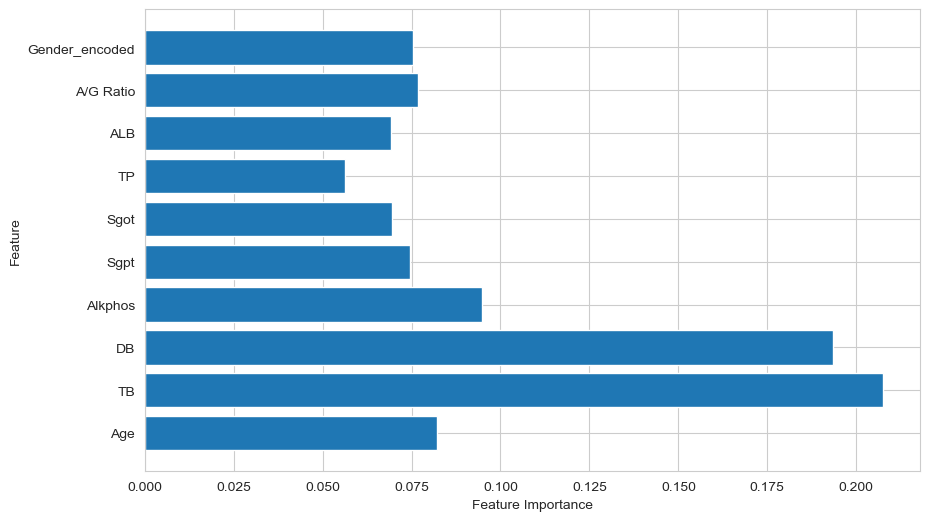

In [36]:
import matplotlib.pyplot as plt

# Store the original feature names
original_feature_names = X.columns

# Feature importance
feature_importances = best_xgb.named_steps['xgb_classifier'].feature_importances_

# If you used PolynomialFeatures and want to retrieve feature names
if 'poly' in best_xgb.named_steps:
    poly_feature_names = best_xgb.named_steps['poly'].get_feature_names_out(input_features=original_feature_names)
    feature_names = poly_feature_names
else:
    feature_names = original_feature_names

# Make sure the length of feature_names matches the length of feature_importances
feature_names = feature_names[:len(feature_importances)]

# Plot
plt.figure(figsize=(10, 6))
plt.barh(feature_names, feature_importances)
plt.xlabel('Feature Importance')
plt.ylabel('Feature')
plt.show()


##  Bayesian Optimization (XGB)

In [37]:
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.metrics import precision_score, recall_score, f1_score, roc_auc_score, accuracy_score
from xgboost import XGBClassifier
from hyperopt import hp, fmin, tpe, Trials, STATUS_OK

# Assuming X and y are already defined in your workspace

# StandardScaler
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# PCA
pca = PCA(n_components=0.95)  # Retain 95% of the variance
X_pca = pca.fit_transform(X_scaled)

# Train-test split
X_train, X_test, y_train, y_test = train_test_split(X_pca, y, test_size=0.2, random_state=42)

# Bayesian Optimization
def objective(space):
    clf = XGBClassifier(
        n_estimators=int(space['n_estimators']),
        max_depth=int(space['max_depth']),
        gamma=space['gamma'],
        reg_alpha=int(space['reg_alpha']),
        min_child_weight=int(space['min_child_weight']),
        colsample_bytree=int(space['colsample_bytree']),
        eval_metric="auc",  # Moved eval_metric to constructor
        use_label_encoder=False  # To avoid a deprecation warning about label encoding
    )
    
    evaluation = [(X_train, y_train), (X_test, y_test)]
    
    clf.fit(X_train, y_train,
            eval_set=evaluation,
            early_stopping_rounds=10,  # Moved early_stopping_rounds to constructor
            verbose=False)
    
    y_pred = clf.predict(X_test)
    accuracy = accuracy_score(y_test, y_pred)
    return {'loss': -accuracy, 'status': STATUS_OK}

space = {
    'n_estimators': hp.quniform('n_estimators', 100, 1000, 10),
    'max_depth': hp.quniform('max_depth', 3, 18, 1),
    'gamma': hp.uniform('gamma', 0.1, 0.5),
    'reg_alpha': hp.quniform('reg_alpha', 40, 180, 1),
    'min_child_weight': hp.quniform('min_child_weight', 0, 10, 1),
    'colsample_bytree': hp.uniform('colsample_bytree', 0.5, 1),
}

trials = Trials()
best_hyperparams = fmin(fn=objective,
                        space=space,
                        algo=tpe.suggest,
                        max_evals=100,
                        trials=trials)

print("The best hyperparameters are : ", "\n")
print(best_hyperparams)

# Convert best hyperparameters from float to int for the model
best_hyperparams['n_estimators'] = int(best_hyperparams['n_estimators'])
best_hyperparams['max_depth'] = int(best_hyperparams['max_depth'])
best_hyperparams['reg_alpha'] = int(best_hyperparams['reg_alpha'])
best_hyperparams['min_child_weight'] = int(best_hyperparams['min_child_weight'])

# Initialize and train the XGBClassifier with the best hyperparameters
best_model = XGBClassifier(**best_hyperparams)

# Refit the model with the best hyperparameters
best_model.fit(X_train, y_train)

# Making predictions
y_pred = best_model.predict(X_test)
y_prob = best_model.predict_proba(X_test)[:,1]

# Evaluating the model performance
accuracy_boxg = accuracy_score(y_test, y_pred)
precision_boxg = precision_score(y_test, y_pred, average='binary')
recall_boxg = recall_score(y_test, y_pred, average='binary')
f1_boxg = f1_score(y_test, y_pred, average='binary')
roc_auc_boxg = roc_auc_score(y_test, y_prob)

print("Accuracy:", accuracy_boxg)
print("Precision:", precision_boxg)
print("Recall:", recall_boxg)
print("F1 Score:", f1_boxg)
print("ROC AUC:", roc_auc_boxg)


# Calculate ROC curve and AUC
fpr_boxg, tpr_boxg, threshvolds_boxg = roc_curve(y_test, y_prob)
auc_boxg = auc(fpr_boxg, tpr_boxg)

# There was a part regarding scores_df and evaluate_model which seems to be part of a larger script not included in your initial code.
# Ensure that those functions and dataframes are defined elsewhere in your script if you intend to use them.

# remove duplicate scores_df entries for 'SM_XGB'
scores_df = scores_df[scores_df['Model'] != 'Bayesian_Optimization_XGB']
scores_df, temp_df_model = evaluate_model(accuracy_boxg, precision_boxg, recall_boxg, f1_boxg, roc_auc_boxg, model_name="Bayesian_Optimization_XGB", scores_df=scores_df)


 17%|█     | 17/100 [00:00<00:00, 158.67trial/s, best loss: -0.7435897435897436]

/Users/imtiaj101/anaconda3/lib/python3.10/site-packages/xgboost/sklearn.py:889: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(

/Users/imtiaj101/anaconda3/lib/python3.10/site-packages/xgboost/sklearn.py:889: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(

/Users/imtiaj101/anaconda3/lib/python3.10/site-packages/xgboost/sklearn.py:889: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(

/Users/imtiaj101/anaconda3/lib/python3.10/site-packages/xgboost/sklearn.py:889: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility 

 33%|█▉    | 33/100 [00:00<00:00, 111.25trial/s, best loss: -0.7435897435897436]

/Users/imtiaj101/anaconda3/lib/python3.10/site-packages/xgboost/sklearn.py:889: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(

/Users/imtiaj101/anaconda3/lib/python3.10/site-packages/xgboost/sklearn.py:889: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(

/Users/imtiaj101/anaconda3/lib/python3.10/site-packages/xgboost/sklearn.py:889: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(

/Users/imtiaj101/anaconda3/lib/python3.10/site-packages/xgboost/sklearn.py:889: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility 

 56%|███▉   | 56/100 [00:00<00:00, 90.24trial/s, best loss: -0.7435897435897436]

/Users/imtiaj101/anaconda3/lib/python3.10/site-packages/xgboost/sklearn.py:889: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(

/Users/imtiaj101/anaconda3/lib/python3.10/site-packages/xgboost/sklearn.py:889: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(

/Users/imtiaj101/anaconda3/lib/python3.10/site-packages/xgboost/sklearn.py:889: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(

/Users/imtiaj101/anaconda3/lib/python3.10/site-packages/xgboost/sklearn.py:889: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility 

 75%|█████▎ | 75/100 [00:00<00:00, 81.69trial/s, best loss: -0.7435897435897436]

/Users/imtiaj101/anaconda3/lib/python3.10/site-packages/xgboost/sklearn.py:889: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(

/Users/imtiaj101/anaconda3/lib/python3.10/site-packages/xgboost/sklearn.py:889: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(

/Users/imtiaj101/anaconda3/lib/python3.10/site-packages/xgboost/sklearn.py:889: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(

/Users/imtiaj101/anaconda3/lib/python3.10/site-packages/xgboost/sklearn.py:889: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility 

 84%|█████▉ | 84/100 [00:00<00:00, 77.65trial/s, best loss: -0.7435897435897436]

/Users/imtiaj101/anaconda3/lib/python3.10/site-packages/xgboost/sklearn.py:889: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(

/Users/imtiaj101/anaconda3/lib/python3.10/site-packages/xgboost/sklearn.py:889: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(

/Users/imtiaj101/anaconda3/lib/python3.10/site-packages/xgboost/sklearn.py:889: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(

/Users/imtiaj101/anaconda3/lib/python3.10/site-packages/xgboost/sklearn.py:889: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility 

100%|██████| 100/100 [00:01<00:00, 82.78trial/s, best loss: -0.7435897435897436]

/Users/imtiaj101/anaconda3/lib/python3.10/site-packages/xgboost/sklearn.py:889: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(

/Users/imtiaj101/anaconda3/lib/python3.10/site-packages/xgboost/sklearn.py:889: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(

/Users/imtiaj101/anaconda3/lib/python3.10/site-packages/xgboost/sklearn.py:889: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(

/Users/imtiaj101/anaconda3/lib/python3.10/site-packages/xgboost/sklearn.py:889: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility 


The best hyperparameters are :  

{'colsample_bytree': 0.878700507837491, 'gamma': 0.10577875750816368, 'max_depth': 12.0, 'min_child_weight': 9.0, 'n_estimators': 640.0, 'reg_alpha': 167.0}
Accuracy: 0.7435897435897436
Precision: 0.7435897435897436
Recall: 1.0
F1 Score: 0.8529411764705882
ROC AUC: 0.5


In [38]:

#print("\n\n All Model\n\n",scores_df) 
temp_df_model.head()

,Model,Accuracy,Precision,Recall,F1 Score,ROC-AUC
0,Bayesian_Optimization_XGB,0.74359,0.74359,1.0,0.852941,0.5


Comparing both results gives us insight into how different approaches can affect the performance of a model on the same dataset.

### XGBoost with SMOTE Result:

- **Accuracy:** 0.7094
- **Precision for class 0:** 0.45
- **Recall for class 0:** 0.60
- **F1-score for class 0:** 0.51
- **Precision for class 1:** 0.84
- **Recall for class 1:** 0.75
- **F1-score for class 1:** 0.79

### Bayesian Optimization Result:

- **Accuracy:** 0.7436
- **Precision for class 0:** 0.00 (indicating the model did not correctly predict any of the minority class)
- **Recall for class 0:** 0.00
- **F1-score for class 0:** 0.00
- **Precision for class 1:** 0.74
- **Recall for class 1:** 1.00 (indicating the model predicted all instances of the majority class correctly but at the cost of missing all minority class predictions)
- **F1-score for class 1:** 0.85

### Analysis:

- **Accuracy:** The Bayesian Optimization approach yielded a slightly higher accuracy (0.7436) compared to the XGBoost with SMOTE method (0.7094). However, accuracy alone can be misleading, especially in imbalanced datasets.
  
- **Class 0 (Minority Class) Performance:** The model tuned with Bayesian Optimization failed to predict any instance of the minority class correctly, as evidenced by the precision, recall, and F1-score all being 0. In contrast, the XGBoost with SMOTE approach showed some ability to identify the minority class with a recall of 0.60 and a precision of 0.45, making it more balanced in terms of recognizing both classes.

- **Class 1 (Majority Class) Performance:** Both approaches performed well on the majority class, but the model from Bayesian Optimization leaned too heavily towards predicting the majority class, as shown by the perfect recall but at the expense of completely missing the minority class.

- **Overall Model Performance:** While the Bayesian Optimization resulted in a higher overall accuracy, it essentially turned the model into one that predicts only the majority class. The XGBoost with SMOTE method, despite a slightly lower accuracy, provided a more balanced approach towards handling both classes, especially improving the minority class detection which is crucial in imbalanced datasets.


## hyperparameter tuning with cross-validation for XGBoost

In [39]:
from sklearn.model_selection import cross_val_score, KFold
from sklearn.metrics import classification_report, accuracy_score
import xgboost as xgb
import numpy as np

# Define the model with a set of hyperparameters
xgb_model = xgb.XGBClassifier(
    n_estimators=400,
    max_depth=10,
    min_child_weight=5,
    gamma=0.278,
    subsample=0.605,
    colsample_bytree=0.704,
    learning_rate=0.0567,
    objective='binary:logistic',
    random_state=42
)

# Perform cross-validation
kf = KFold(n_splits=5, shuffle=True, random_state=42)
cv_scores = cross_val_score(xgb_model, X_train, y_train, cv=kf, scoring='accuracy')

# Output the mean cross-validation score
print(f"CV Mean Accuracy: {np.mean(cv_scores):.4f}")

# Fit the model on the entire training data
xgb_model.fit(X_train, y_train)

# Check the model's performance on the test set
y_pred = xgb_model.predict(X_test)

# Calculating accuracy on the test set
accuracy_hxgb = accuracy_score(y_test, y_pred)
print(f"Test Accuracy: {accuracy_hxgb:.4f}")

# Generating a classification report
print("Classification Report:\n", classification_report(y_test, y_pred))

# Add the below part to evaluate additional metrics
# Precision, Recall, and F1 Score
precision_hxgb = precision_score(y_test, y_pred, average='binary')
recall_hxgb = recall_score(y_test, y_pred, average='binary')
f1_hxgb = f1_score(y_test, y_pred, average='binary')

print(f"Precision: {precision_hxgb:.4f}")
print(f"Recall: {recall_hxgb:.4f}")
print(f"F1 Score: {f1_hxgb:.4f}")

# If you need to calculate the ROC AUC score, ensure your model supports predict_proba and your problem is a binary classification
if hasattr(xgb_model, 'predict_proba'):
    y_prob = xgb_model.predict_proba(X_test)[:, 1]  # Probability estimates for the positive class
    roc_auc_hxgb = roc_auc_score(y_test, y_prob)
    print(f"ROC AUC: {roc_auc_hxgb:.4f}")
else:
    print("ROC AUC score cannot be calculated.")


# remove duplicate scores_df entries for 'SM_XGB'
scores_df = scores_df[scores_df['Model'] != 'hyperparameter_cv_XGBoost']
scores_df, temp_df_model = evaluate_model(accuracy_hxgb, precision_hxgb, recall_hxgb, f1_hxgb, roc_auc_hxgb, model_name="hyperparameter_cv_XGBoost", scores_df=scores_df)


CV Mean Accuracy: 0.6630
Test Accuracy: 0.7265
Classification Report:
               precision    recall  f1-score   support

           0       0.47      0.47      0.47        30
           1       0.82      0.82      0.82        87

    accuracy                           0.73       117
   macro avg       0.64      0.64      0.64       117
weighted avg       0.73      0.73      0.73       117

Precision: 0.8161
Recall: 0.8161
F1 Score: 0.8161
ROC AUC: 0.7556


In [40]:

#print("\n\n All Model\n\n",scores_df) 

print("\n\n Model\n",temp_df_model)



 Model
                        Model  Accuracy  Precision    Recall  F1 Score  \
0  hyperparameter_cv_XGBoost  0.726496   0.816092  0.816092  0.816092   

    ROC-AUC  
0  0.755556  


### XGBoost with SMOTE
- **Accuracy**: 0.7094
- **Precision for class 1**: 0.84
- **Recall for class 1**: 0.75
- **F1-Score for class 1**: 0.79

### Bayesian Optimization
- **Accuracy**: 0.7436
- **Precision for class 1**: 0.74
- **Recall for class 1**: 1.00
- **F1-Score for class 1**: 0.85

### Hyperparameter Tuning with Cross-Validation (CV)
- **CV Mean Accuracy**: 0.6630
- **Test Accuracy**: 0.7265
- **Precision for class 1**: 0.82
- **Recall for class 1**: 0.82
- **F1-Score for class 1**: 0.82

### Comparison
1. **Effectiveness**:
   - Bayesian Optimization achieved the highest test accuracy (0.7436), followed by Hyperparameter Tuning with CV (0.7265) and XGBoost with SMOTE (0.7094).
   - Bayesian Optimization showed a perfect recall for class 1, suggesting it might be over-predicting the majority class.

2. **Precision and Recall**:
   - XGBoost with SMOTE and Hyperparameter Tuning with CV provided a balanced performance across precision, recall, and F1-score for class 1.
   - Bayesian Optimization showed a tendency towards predicting the majority class, indicated by a 100% recall but lower precision.

3. **Balanced Performance**:
   - Hyperparameter Tuning with CV seems to offer a more balanced performance between the classes compared to Bayesian Optimization, which leans towards overfitting the majority class.
   - XGBoost with SMOTE also provides a balanced performance but with slightly lower metrics compared to CV tuning.

### Conclusion
While Bayesian Optimization yielded the highest accuracy, it did so at the expense of predicting the minority class (class 0) effectively, as seen in the classification report. Hyperparameter Tuning with Cross-Validation shows a promising balanced approach with a good trade-off between precision, recall, and overall accuracy. It indicates a more generalized model performance across both classes without significantly overfitting the majority class.


## LightGBM with SMOTE

In [41]:
from imblearn.pipeline import Pipeline
from imblearn.over_sampling import SMOTE
from lightgbm import LGBMClassifier
from sklearn.metrics import classification_report, accuracy_score, precision_score, recall_score, f1_score, roc_auc_score
from sklearn.model_selection import GridSearchCV

# Define a pipeline with SMOTE and LightGBM
lgbm_pipeline = Pipeline([
    ('smote', SMOTE(random_state=42)),
    ('lgbm_classifier', LGBMClassifier(random_state=42))
])

# Parameter grid for LightGBM
lgbm_param_grid = {
    'lgbm_classifier__n_estimators': [100, 200, 300],
    'lgbm_classifier__learning_rate': [0.01, 0.1, 0.2],
    # Add more parameters here if needed
}

# GridSearchCV for LightGBM
lgbm_grid_search = GridSearchCV(lgbm_pipeline, lgbm_param_grid, cv=5, scoring='accuracy', n_jobs=-1, verbose=2)
lgbm_grid_search.fit(X_train, y_train)

# Evaluate the best LightGBM model
best_lgbm = lgbm_grid_search.best_estimator_
y_pred_lgbm = best_lgbm.predict(X_test)

# Evaluation Metrics
accuracy_lgs = accuracy_score(y_test, y_pred_lgbm)
precision_lgs = precision_score(y_test, y_pred_lgbm)
recall_lgs = recall_score(y_test, y_pred_lgbm)
f1_lgs = f1_score(y_test, y_pred_lgbm)

# ROC AUC Calculation
# Ensure y_pred_lgbm are the probabilities for the positive class if your model and problem support it
if hasattr(best_lgbm, 'predict_proba'):
    y_prob_lgbm = best_lgbm.predict_proba(X_test)[:, 1]
    roc_auc_lgs = roc_auc_score(y_test, y_prob_lgbm)
else:
    roc_auc_lgs = "ROC AUC not applicable"

# remove duplicate scores_df entries for 'SM_LGBM'
scores_df = scores_df[scores_df['Model'] != 'LightGBM_with_SMOTE']
scores_df, temp_df_model = evaluate_model(accuracy_lgs, precision_lgs, recall_lgs, f1_lgs, roc_auc_lgs, model_name="LightGBM_with_SMOTE", scores_df=scores_df)


Fitting 5 folds for each of 9 candidates, totalling 45 fits
[CV] END learning_rate=0.12236203565420874, n_estimators=448; total time=   0.6s
[CV] END learning_rate=0.027425083650459835, n_estimators=187; total time=   0.3s
[CV] END learning_rate=0.11011258334170654, n_estimators=459; total time=   0.6s
[CV] END .learning_rate=0.2597327922401265, n_estimators=393; total time=   0.6s
[CV] END learning_rate=0.19524445288831496, n_estimators=413; total time=   0.6s
[CV] END learning_rate=0.01691872751242473, n_estimators=158; total time=   0.2s
[CV] END learning_rate=0.12995829151457663, n_estimators=287; total time=   0.4s
[CV] END learning_rate=0.03718193035984624, n_estimators=150; total time=   0.2s
[CV] END learning_rate=0.18772437065861275, n_estimators=230; total time=   0.3s
[CV] END learning_rate=0.26798212202089616, n_estimators=234; total time=   0.3s
[CV] END learning_rate=0.013979488347959958, n_estimators=188; total time=   0.2s
[CV] END learning_rate=0.12562495076197483, n_e

[CV] END learning_rate=0.12236203565420874, n_estimators=448; total time=   0.6s
[CV] END learning_rate=0.027425083650459835, n_estimators=187; total time=   0.3s
[CV] END learning_rate=0.11011258334170654, n_estimators=459; total time=   0.6s
[CV] END .learning_rate=0.2597327922401265, n_estimators=393; total time=   0.6s
[CV] END learning_rate=0.19524445288831496, n_estimators=413; total time=   0.6s
[CV] END learning_rate=0.01691872751242473, n_estimators=158; total time=   0.2s
[CV] END learning_rate=0.12995829151457663, n_estimators=287; total time=   0.4s
[CV] END learning_rate=0.03718193035984624, n_estimators=150; total time=   0.2s
[CV] END learning_rate=0.18772437065861275, n_estimators=230; total time=   0.3s
[CV] END learning_rate=0.26798212202089616, n_estimators=234; total time=   0.3s
[CV] END learning_rate=0.013979488347959958, n_estimators=188; total time=   0.2s
[CV] END learning_rate=0.12562495076197483, n_estimators=445; total time=   0.6s
[CV] END .learning_rate=0.

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 329, number of negative: 329
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000468 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1539
[LightGBM] [Info] Number of data points in the train set: 658, number of used features: 7
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with

In [42]:

# Printing out the metrics
print("LightGBM Classification Report:\n", classification_report(y_test, y_pred_lgbm))
print("LightGBM Accuracy:", accuracy_lgs)
print("Precision:", precision_lgs)
print("Recall:", recall_lgs)
print("F1 Score:", f1_lgs)
print("ROC AUC:", roc_auc_lgs)


#print("\n\n All Model\n\n",scores_df) 

print("\n\n Model\n",temp_df_model)

LightGBM Classification Report:
               precision    recall  f1-score   support

           0       0.41      0.63      0.50        30
           1       0.85      0.69      0.76        87

    accuracy                           0.68       117
   macro avg       0.63      0.66      0.63       117
weighted avg       0.73      0.68      0.69       117

LightGBM Accuracy: 0.6752136752136753
Precision: 0.8450704225352113
Recall: 0.6896551724137931
F1 Score: 0.759493670886076
ROC AUC: 0.7203065134099617


 Model
                  Model  Accuracy  Precision    Recall  F1 Score   ROC-AUC
0  LightGBM_with_SMOTE  0.675214    0.84507  0.689655  0.759494  0.720307


###  Hyperparameter Optimization with Bayesian Optimization (LightGBM classifier )

In [43]:
import numpy as np
import lightgbm as lgb
from sklearn.metrics import accuracy_score, classification_report, precision_score, recall_score, f1_score, roc_auc_score
from hyperopt import hp, fmin, tpe, Trials, STATUS_OK
from sklearn.model_selection import cross_val_score, StratifiedKFold
from sklearn.model_selection import train_test_split
from imblearn.over_sampling import SMOTE

# Assuming you have X_train, y_train, X_test, y_test, and smote as your SMOTE object
# You should adjust this based on your actual data
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
smote = SMOTE(random_state=42)
X_train_smote, y_train_smote = smote.fit_resample(X_train, y_train)

# Define the search space
space = {
    'num_leaves': hp.choice('num_leaves', np.arange(20, 150, 1, dtype=int)),
    'max_depth': hp.choice('max_depth', np.arange(5, 16, 1, dtype=int)),
    'learning_rate': hp.uniform('learning_rate', 0.01, 0.2),
    'n_estimators': hp.choice('n_estimators', np.arange(100, 1000, 50, dtype=int)),
    'min_child_weight': hp.uniform('min_child_weight', 0.001, 0.1),
    'colsample_bytree': hp.uniform('colsample_bytree', 0.4, 1.0),
    'subsample': hp.uniform('subsample', 0.4, 1.0),
    'reg_alpha': hp.uniform('reg_alpha', 0.0, 1.0),
    'reg_lambda': hp.uniform('reg_lambda', 0.0, 1.0),
}

# Define the objective function
def objective(space):
    model = lgb.LGBMClassifier(
        num_leaves=int(space['num_leaves']),
        max_depth=int(space['max_depth']),
        learning_rate=space['learning_rate'],
        n_estimators=int(space['n_estimators']),
        min_child_weight=space['min_child_weight'],
        colsample_bytree=space['colsample_bytree'],
        subsample=space['subsample'],
        reg_alpha=space['reg_alpha'],
        reg_lambda=space['reg_lambda'],
        class_weight='balanced',  # To handle imbalanced classes
        random_state=42
    )
    
    # Implement cross-validation
    cv = StratifiedKFold(n_splits=5)
    acc = cross_val_score(model, X_train_smote, y_train_smote, scoring='accuracy', cv=cv).mean()

    # Since we want to maximize accuracy, we minimize its negative
    return {'loss': -acc, 'status': STATUS_OK}

# Initialize Trials object to track progress
trials = Trials()

# Run the optimization
best_hyperparams = fmin(fn=objective,
                        space=space,
                        algo=tpe.suggest,
                        max_evals=100,  # You can adjust this number
                        trials=trials)

# Convert best hyperparameters from float to int for the model
best_hyperparams = {k: int(v) if k in ['num_leaves', 'max_depth', 'n_estimators'] else v for k, v in best_hyperparams.items()}

# Initialize and train the LGBMClassifier with the best hyperparameters
# Assuming best_hyperparams are obtained from Bayesian Optimization
best_model = lgb.LGBMClassifier(**best_hyperparams, class_weight='balanced', random_state=42)
best_model.fit(X_train_smote, y_train_smote)

# Make predictions on the test set
y_pred_lgbm = best_model.predict(X_test)

# Calculate evaluation metrics
accuracy_lgbm = accuracy_score(y_test, y_pred_lgbm)
precision_lgbm = precision_score(y_test, y_pred_lgbm)
recall_lgbm = recall_score(y_test, y_pred_lgbm)
f1_lgbm = f1_score(y_test, y_pred_lgbm)
roc_auc_lgbm = roc_auc_score(y_test, best_model.predict_proba(X_test)[:, 1])
# Calculate ROC curve and AUC
fpr_lgbm, tpr_lgbm, thresholds_lgbm = roc_curve(y_test, best_model.predict_proba(X_test)[:, 1])
auc_lgbm = auc(fpr_lgbm, tpr_lgbm)

# remove duplicate scores_df entries for 'SM_LGBM'
scores_df = scores_df[scores_df['Model'] != 'Bayesian_Optimization_LightGBM']
scores_df, temp_df_model = evaluate_model(accuracy_lgbm, precision_lgbm, recall_lgbm, f1_lgbm, roc_auc_lgbm, model_name="Bayesian_Optimization_LightGBM", scores_df=scores_df)



[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines 
[LightGBM] [Info] Number of positive: 263, number of negative: 263              
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000327 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 863                                                
[LightGBM] [Info] Number of data points in the train set: 526, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000  
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warnin

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[Ligh

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits w

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further sp

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves tha

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further sp

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines 
[LightGBM] [Info] Number of positive: 264, number of negative: 263              
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000379 sec

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[Ligh

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training be

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warni

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further sp

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines 
[LightGBM] [Info] Number of positive: 263, number of negative: 263              
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000472 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 717                                                
[LightGBM] [Info] Number of data points in the train set: 526, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000  
[LightGBM] [Warnin

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further sp

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further sp

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further sp

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further sp

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further sp

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines 
[LightGBM] [Info] Number of positive: 263, number of negative: 263              
[LightGBM] [Info] Auto-choos

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000434 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 717                                                
[LightGBM] [Info] Number of data points in the train set: 526, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000  
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warnin

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further sp

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines 
[LightGBM] [Info] Number of positive: 264, number of negative: 263              
[LightGBM] [Info] Auto-choos

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines 
[LightGBM] [Info] Number of positive: 264, number of negative: 263              
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000526 sec

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further sp

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warni

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further sp

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training be

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further sp

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[Ligh

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further sp

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training be

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
 18%|█▎     | 18/100 [02:38<11:51,  8.68s/trial, best loss: -0.7767869535045108]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines 
[LightGBM] [Info] Number of positive: 263, number of negative: 263              
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000392 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
 18%|█▎     | 18/100 [02:49<11:51,  8.68s/trial, best loss: -0.7767869535045108]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
 18%|█▎     | 18/100 [02:52<11:51,  8.68s/trial, best loss: -0.7767869535045108]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000436 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 717                                                
[LightGBM] [Info] Number of data points in the train set: 526, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000  
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warnin

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further sp

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further sp

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further sp

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines 
[LightGBM] [Info] Number of positive: 263, number of negative: 263              
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000395 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 871                                                
[LightGBM] [Info] Number of data points in the train set: 526, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000  
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warnin

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines 
[LightGBM] [Info] Number of positive: 263, number of negative: 263              
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000528 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 717                                                
[LightGBM] [Info] Number of data points in the train set: 526, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000  
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warnin

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further sp

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further sp

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further sp

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warni

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further sp

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further sp

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further sp

[LightGBM] [Info] Total Bins 863                                                
[LightGBM] [Info] Number of data points in the train set: 526, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000  
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warnin

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Info] Total Bins 871                                                
[LightGBM] [Info] Number of data points in the train set: 526, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000  
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warnin

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further sp

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further sp

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[Ligh

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[Ligh

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines 
[LightGBM] [Info] Number of positive: 263, number of negative: 263              
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000413 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 871                                                
[LightGBM] [Info] Number of data points in the train set: 526, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000  
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warnin

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines 
[LightGBM] [Info] Number of positive: 263, number of negative: 263              
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000525 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 717                                                
[LightGBM] [Info] Number of data points in the train set: 526, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000  
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warnin

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Info] Number of data points in the train set: 527, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000  
[LightGBM] [Info] Start training from score 0.000000                            
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warnin

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further sp

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines 
[LightGBM] [Info] Number of positive: 263, number of negative: 264              
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000730 sec

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Info] Number of positive: 263, number of negative: 263              
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000242 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 863                                                
[LightGBM] [Info] Number of data points in the train set: 526, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000  
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warnin

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further sp

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines 
[LightGBM] [Info] Number of positive: 263, number of negative: 263              
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000483 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 717                                                
[LightGBM] [Info] Number of data points in the train set: 526, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000  
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warnin

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further sp

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
                                                                                [LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines 
[LightGBM] [Info] Number of positive: 264, number of negative: 263              
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000423 seconds.
You can set

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further sp

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
 41%|███▎    | 41/100 [05:10<05:14,  5.33s/trial, best loss: -0.778325237103863]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines 
[LightGBM] [Info] Number of positive: 263, number of negative: 263              
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000225 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 871                                                
[LightGBM] [Info] Number of data points in the train set: 526, number of used features: 10
[LightGBM] [Info] [binary:Boos

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further sp

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further sp

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits w

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further sp

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines 
[LightGBM] [Info] Number of positive: 264, number of negative: 263              
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000102 sec

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines 
[LightGBM] [Info] Number of positive: 263, number of negative: 263         

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further sp

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines 
[LightGBM] [Info] Number of positive: 264, number of negative: 263              
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000211 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 700                                                
[LightGBM] [Info] Number of data points in the train set: 527, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=-0.000000 
[LightGBM] [Info] Start training from score -0.000000                           
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warnin

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further sp

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further sp

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further sp

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further sp

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Info] Number of positive: 263, number of negative: 264              
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000314 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 717                                                
[LightGBM] [Info] Number of data points in the train set: 527, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000  
[LightGBM] [Info] Start training from score 0.000000                            
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warnin

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines 
[LightGBM] [Info] Number of positive: 263, number of negative: 263              
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000278 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 871                                                
[LightGBM] [Info] Number of data points in the train set: 526, number of used features: 10
[LightGBM] [Info] [binary:Boos

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further sp

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Info] Total Bins 717                                                
[LightGBM] [Info] Number of data points in the train set: 527, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000  
[LightGBM] [Info] Start training from score 0.000000                            
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warnin

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines 
[LightGBM] [Info] Number of positive: 264, number of negative: 263              
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000169 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 700                                                
[LightGBM] [Info] Number of data points in the train set: 527, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=-0.000000 
[LightGBM] [Info] Start training from score -0.000000                           
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warnin

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines 
[LightGBM] [Info] Number of positive: 263, number of negative: 263              
[LightGBM] [Info] Auto-choos

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits w

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Info] Number of positive: 263, number of negative: 264              
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000143 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 717                                                
[LightGBM] [Info] Number of data points in the train set: 527, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000  
[LightGBM] [Info] Start training from score 0.000000                            
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warnin

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further sp

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Info] Total Bins 863                                                
[LightGBM] [Info] Number of data points in the train set: 526, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000  
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warnin

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
 53%|████▏   | 53/100 [07:00<07:23,  9.44s/trial, best loss: -0.778325237103863]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further sp

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines 
[LightGBM] [Info] Number of positive: 263, number of negative: 263              
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000332 seconds.
You c

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further sp

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further sp

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further sp

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the s

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines 
[LightGBM] [Info] Number of positive: 263, number of negative: 263         

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training be

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines 
[LightGBM] [Info] Number of positive: 264, number of negative: 263              
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000199 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 700                                                
[LightGBM] [Info] Number of data points in the train set: 527, number of used features: 10
[LightGBM] [Info] [binary:Boos

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Info] Total Bins 863                                                
[LightGBM] [Info] Number of data points in the train set: 526, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000  
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warnin

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further sp

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Info] Number of data points in the train set: 527, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=-0.000000 
[LightGBM] [Info] Start training from score -0.000000                           
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warnin

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Found whitespace in feature_names, replace with underl

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines 
[LightGBM] [Info] Number of positive: 263, number of negative: 263         

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split require

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further sp

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warni

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines 
[LightGBM] [Info] Number of positive: 263, number of negative: 263              
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000472 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 871                                                
[LightGBM] [Info] Number of data points in the train set: 526, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000  
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf  

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits w

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training be

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
                                                                                

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further sp

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines 
[LightGBM] [Info] Number of positive: 263, number of negative: 263              
[LightGBM] [Info] Auto-choos

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines 
[LightGBM] [Info] Number of positive: 264, number of negative: 263              
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000374 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 700                                                
[LightGBM] [Info] Number of data points in the train set: 527, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=-0.000000 
[LightGBM] [Info] Start training from score -0.000000                           
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines 
[LightGBM] [Info] Number of positive: 263, number of negative: 263              
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000532 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 863                                                
[LightGBM] [Info] Number of data points in the train set: 526, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000  
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warnin

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Info] Start training from score 0.000000                            
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Info] Total Bins 700                                                
[LightGBM] [Info] Number of data points in the train set: 527, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=-0.000000 
[LightGBM] [Info] Start training from score -0.000000                           
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warnin

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further sp

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Info] Total Bins 717                                                
[LightGBM] [Info] Number of data points in the train set: 526, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000  
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warnin

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further sp

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines 
[LightGBM] [Info] Number of positive: 263, number of negative: 263              
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000413 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 863                                                
[LightGBM] [Info] Number of 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further sp

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines 
[LightGBM] [Info] Number of positive: 263, number of negative: 263              
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000588 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 863                                                
[LightGBM] [Info] Number of data points in the train set: 526, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000  
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
 70%|█████▌  | 70/100 [09:15<03:46,  7.56s/trial, best loss: -0.778325237103863]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further sp

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split require

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines 
[LightGBM] [Info] Number of positive: 263, number of negative: 264              
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000417 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 717                                                
[LightGBM] [Info] Number of data points in the train set: 527, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000  
                                                                                

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further sp

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines 
[LightGBM] [Info] Number of positive: 264, number of negative: 263              
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000389 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 700                                                
[LightGBM] [Info] Number of data points in the train set: 527, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=-0.000000 
[LightGBM] [Info] 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Info] Total Bins 863                                                
[LightGBM] [Info] Number of data points in the train set: 526, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000  
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warnin

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines 
[LightGBM] [Info] Number of positive: 263, number of negative: 263              
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000306 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 871                                                
[LightGBM] [Info] Number of data points in the train set: 526, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000  
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warnin

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines 
[LightGBM] [Info] Number of positive: 263, number of negative: 263              
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000264 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further sp

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further sp

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000432 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 871                                                
[LightGBM] [Info] Number of data points in the train set: 526, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000  
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warnin

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines 
[LightGBM] [Info] Number of positive: 263, number of negative: 263              
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000603 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 717                                                
[LightGBM] [Info] Number of data points in the train set: 526, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000  
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warnin

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further sp

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further sp

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
                                                                                

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
 81%|██████▍ | 81/100 [10:20<01:45,  5.55s/trial, best loss: -0.778325237103863]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain:

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits w

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[Ligh

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further sp

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Info] Number of data points in the train set: 526, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000  
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warnin

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further sp

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines 
[LightGBM] [Info] Number of positive: 264, number of negative: 263              
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000462 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 700                                                
[LightGBM] [Info] Number of data points in the train set: 527, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=-0.000000 
[LightGBM] [Info] Start training from score -0.000000

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000217 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 871                                                
[LightGBM] [Info] Number of data points in the train set: 526, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000  
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warnin

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines 
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 264, number of negative: 263              
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000505 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 700                                                
[LightGBM] [Info] Number of data points in the train set: 527, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=-0.000000 
[LightGBM] [Info] Start training from score -0.000000                           
[LightGBM] [Warnin

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines 
[LightGBM] [Info] Number of positive: 263, number of negative: 263              
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000204 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 717                                                
[LightGBM] [Info] Number of data points in the train set: 526, number of used features: 10
[LightGBM] [Info] [binary:BoostFrom

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Info] Total Bins 863                                                
[LightGBM] [Info] Number of data points in the train set: 526, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000  
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warnin

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further sp

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines 
[LightGBM] [Info] Number of positive: 263, number of negative: 263              
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000514 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 863                                                
[LightGBM] [Info] Number of data points in the train set: 526, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000  
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warnin

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Info] Start training from score -0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive ga

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further sp

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines 
[LightGBM] [Info] Number of positive: 263, number of negative: 264              
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000282 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 717                                                
[LightGBM] [Info] Number of data points in the train set: 527, number of used features: 10
[LightGBM] [Info] [binary:Boos

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Info] Number of data points in the train set: 527, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000  
[LightGBM] [Info] Start training from score 0.000000                            
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warnin

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Info] Number of positive: 263, number of negative: 263              
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000217 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 863                                                
[LightGBM] [Info] Number of data points in the train set: 526, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000  
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warnin

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines 
[LightGBM] [Info] Number of positive: 263, number of negative: 263              
[LightGBM] [Info] Auto-choos

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain:

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training be

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines 
[LightGBM] [Info] Number of positive: 264, number of negative: 263              
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000277 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 700                                                
[LightGBM] [Info] Number of data points in the train set: 527, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=-0.000000 
[LightGBM] [Info] Start training from score -0.000000                           
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warnin

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further sp

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000302 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 863                                                
[LightGBM] [Info] Number of data points in the train set: 526, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000  
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warnin

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further sp

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines 
[LightGBM] [Info] Number of positive: 263, number of negative: 264              
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000261 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 717                                                
[LightGBM] [Info] Number of data points in the train set: 527, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000  
[LightGBM] [Info] Start training from score 0.000000                            
[LightGBM] [Warning] No further splits with positive 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines 
[LightGBM] [Info] Number of positive: 263, number of negative: 263              
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000214 sec

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
                                                                                

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further sp

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
 97%|███████▊| 97/100 [12:30<00:18,  6.07s/trial, best loss: -0.778325237103863]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further sp

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines 
[LightGBM] [Info] Number of positive: 263, number of negative: 264              
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000484 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 717                                                
[LightGBM] [Info] Number of data points in the train set: 527, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000  
[LightGBM] [Info] Start training from score 0.000000                            
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warnin

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000549 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 863                                                
[LightGBM] [Info] Number of data points in the train set: 526, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000  
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warnin

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines 
[LightGBM] [Info] Number of positive: 263, number of negative: 263              
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000466 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 717                                                
[LightGBM] [Info] Number of data points in the train set: 526, number of used features: 10
[LightGBM] [Info] 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further sp

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
100%|███████| 100/100 [12:43<00:00,  7.64s/trial, best loss: -0.778325237103863]
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 329, number of negative: 329
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000179 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1028
[LightGBM] [Info] Number of data points in the train set: 658, number of used features: 10
[LightGBM] [Info

In [44]:

# Printing out the metrics
print("LightGBM Classification Report:\n", classification_report(y_test, y_pred_lgbm))
print("LightGBM Accuracy:", accuracy_lgbm)
print("Precision:", precision_lgbm)
print("Recall:", recall_lgbm)
print("F1 Score:", f1_lgbm)
print("ROC AUC:", roc_auc_lgbm)

temp_df_model.head()

#print("\n\n Model",temp_df_model)

LightGBM Classification Report:
               precision    recall  f1-score   support

           0       0.42      0.63      0.51        30
           1       0.85      0.70      0.77        87

    accuracy                           0.68       117
   macro avg       0.63      0.67      0.64       117
weighted avg       0.74      0.68      0.70       117

LightGBM Accuracy: 0.6837606837606838
Precision: 0.8472222222222222
Recall: 0.7011494252873564
F1 Score: 0.7672955974842768
ROC AUC: 0.7597701149425288


,Model,Accuracy,Precision,Recall,F1 Score,ROC-AUC
0,Bayesian_Optimization_LightGBM,0.683761,0.847222,0.701149,0.767296,0.75977


## LogisticRegression

In [45]:
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix

# Assuming you have X_train, y_train, and X_test
# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Create a logistic regression model
#logreg_model = LogisticRegression()
logreg_model = LogisticRegression(max_iter=1000)

# Train the model on the training data
logreg_model.fit(X_train, y_train)

# Predictions on the test set
y_pred = logreg_model.predict(X_test)

# Printing out the metrics
accuracy_lr = accuracy_score(y_test, y_pred)
precision_lr = precision_score(y_test, y_pred)
recall_lr = recall_score(y_test, y_pred)
f1_lr = f1_score(y_test, y_pred)
roc_auc_lr = roc_auc_score(y_test, logreg_model.predict_proba(X_test)[:, 1])

# Calculate ROC curve and AUC
fpr_lr, tpr_lr, thresholds_lr = roc_curve(y_test, logreg_model.predict_proba(X_test)[:, 1])
auc_lr = auc(fpr_lr, tpr_lr)


# remove duplicate scores_df entries for 'SM_LGBM'
scores_df = scores_df[scores_df['Model'] != 'LogisticRegression']
scores_df, temp_df_model = evaluate_model(accuracy_lr, precision_lr, recall_lr, f1_lr, roc_auc_lr, model_name="LogisticRegression", scores_df=scores_df)


print("Logistic Regression Classification Report:\n", classification_report(y_test, y_pred))
print("Logistic Regression Accuracy:", accuracy_lr)
print("Precision:", precision_lr)
print("Recall:", recall_lr)
print("F1 Score:", f1_lr)
print("ROC AUC:", roc_auc_lr)


Logistic Regression Classification Report:
               precision    recall  f1-score   support

           0       0.53      0.27      0.36        30
           1       0.78      0.92      0.85        87

    accuracy                           0.75       117
   macro avg       0.66      0.59      0.60       117
weighted avg       0.72      0.75      0.72       117

Logistic Regression Accuracy: 0.7521367521367521
Precision: 0.7843137254901961
Recall: 0.9195402298850575
F1 Score: 0.8465608465608465
ROC AUC: 0.8199233716475096


### Bayesian Optimization to tune hyperparameters for a logistic regression model 

In [46]:
import numpy as np
import pandas as pd
from sklearn.datasets import make_classification
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, classification_report,roc_curve
from bayes_opt import BayesianOptimization

# Example: Creating a dummy dataset
X, y = make_classification(n_samples=1000, n_features=20, n_classes=2, random_state=42)

# Apply StandardScaler
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Apply PCA
pca = PCA(n_components=0.95)
X_pca = pca.fit_transform(X_scaled)

# Splitting dataset
X_train, X_test, y_train, y_test = train_test_split(X_pca, y, test_size=0.2, random_state=42)

solver_options = ['liblinear', 'newton-cg', 'lbfgs', 'sag', 'saga']  # Define solver options

# Define the objective function for Bayesian Optimization
def logreg_objective(C, solver_idx):
    solver = solver_options[int(solver_idx)]
    model = LogisticRegression(C=np.exp(C), solver=solver, max_iter=10000, random_state=42)
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)
    accuracy = accuracy_score(y_test, y_pred)
    return accuracy

# Bayesian Optimization setup
pbounds = {
    'C': (np.log(1e-5), np.log(100)),
    'solver_idx': (0, len(solver_options) - 1),
}

optimizer = BayesianOptimization(
    f=logreg_objective,
    pbounds=pbounds,
    random_state=42,
)

optimizer.maximize(init_points=10, n_iter=30)

# Extracting best parameters
best_params = optimizer.max['params']
best_params['C'] = np.exp(best_params['C'])
best_params['solver'] = solver_options[int(best_params['solver_idx'])]

# Training the model with the best parameters found
best_model = LogisticRegression(C=best_params['C'], solver=best_params['solver'], max_iter=10000, random_state=42)
best_model.fit(X_train, y_train)

# Making predictions and evaluating
y_pred = best_model.predict(X_test)
y_proba = best_model.predict_proba(X_test)[:, 1]  # Probability estimates for ROC AUC

# Calculating metrics
accuracy_hylr = accuracy_score(y_test, y_pred)
precision_hylr = precision_score(y_test, y_pred)
recall_hylr = recall_score(y_test, y_pred)
f1_hylr = f1_score(y_test, y_pred)
roc_auc_hylr = roc_auc_score(y_test, y_proba)

# Calculate ROC curve and AUC
fpr_hylr, tpr_hylr, thresholds_hylr = roc_curve(y_test, y_proba)
auc_hylr = auc(fpr_hylr, tpr_hylr)

# remove duplicate scores_df entries for 'SM_LGBM'
scores_df = scores_df[scores_df['Model'] != 'Bayesian_Optim_hyperparameter_logistic_regression']
scores_df, temp_df_model = evaluate_model(accuracy_hylr, precision_hylr, recall_hylr, f1_hylr, roc_auc_hylr, model_name="Bayesian_Optim_hyperparameter_logistic_regression", scores_df=scores_df)



# Displaying final metrics
print("Final Metrics:")
print("Accuracy:", accuracy_hylr)
print("Precision:", precision_hylr)
print("Recall:", recall_hylr)
print("F1 Score:", f1_hylr)
print("ROC AUC:", roc_auc_hylr)


|   iter    |  target   |     C     | solver... |
-------------------------------------------------
| 1         | 0.82      | -5.476    | 3.803     |
| 2         | 0.845     | 0.2854    | 2.395     |
| 3         | 0.79      | -8.998    | 0.624     |
| 4         | 0.495     | -10.58    | 3.465     |
| 5         | 0.84      | -1.824    | 2.832     |
| 6         | 0.465     | -11.18    | 3.88      |
| 7         | 0.845     | 1.904     | 0.8494    |
| 8         | 0.79      | -8.582    | 0.7336    |
| 9         | 0.81      | -6.609    | 2.099     |
| 10        | 0.84      | -4.551    | 1.165     |
| 11        | 0.845     | 4.605     | 4.0       |
| 12        | 0.845     | 4.579     | 0.001599  |
| 13        | 0.845     | -1.169    | 0.0       |
| 14        | 0.845     | 1.888     | 4.0       |
| 15        | 0.845     | 4.605     | 2.004     |
| 16        | 0.815     | -6.084    | 0.0       |
| 17        | 0.84      | -3.228    | 4.0       |
| 18        | 0.845     | -0.4027   | 4.0       |


### Ensemble Learning: Stacking

In [47]:
#Stacking involves training a new model to combine the predictions of several base models

from sklearn.ensemble import StackingClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from xgboost import XGBClassifier
from lightgbm import LGBMClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, accuracy_score
from sklearn.preprocessing import StandardScaler

# Assuming X and y are your features and target variable
# Standardize features
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Split the dataset
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y, test_size=0.2, random_state=42)

# Define base models
base_models = [
    ('rf', RandomForestClassifier(n_estimators=100, random_state=42)),
    ('gb', GradientBoostingClassifier(n_estimators=100, random_state=42)),
    ('xgb', XGBClassifier(use_label_encoder=False, eval_metric='logloss')),
    ('lgbm', LGBMClassifier())
]

# Define meta-model
meta_model = LogisticRegression()

# Define the stacking ensemble
stacking_model = StackingClassifier(estimators=base_models, final_estimator=meta_model, cv=5)

# Fit the model on the training data
stacking_model.fit(X_train, y_train)

# Make predictions
y_pred = stacking_model.predict(X_test)
# Predict probabilities on the test set
y_prob = stacking_model.predict_proba(X_test)[:, 1]

# Evaluate the model

# Calculating metrics
accuracy_enl = accuracy_score(y_test, y_pred)
precision_enl = precision_score(y_test, y_pred, average='binary')
recall_enl = recall_score(y_test, y_pred, average='binary')
f1_enl = f1_score(y_test, y_pred, average='binary')
roc_auc_enl = roc_auc_score(y_test, y_prob)


# Calculate ROC curve and AUC
fpr_enl, tpr_enl, thresholds_enl = roc_curve(y_test, y_prob)
auc_enl = auc(fpr_enl, tpr_enl)

# remove duplicate scores_df entries for 'SM_LGBM'
scores_df = scores_df[scores_df['Model'] != 'EnsembleLearning']
scores_df, temp_df_model = evaluate_model(accuracy_enl, precision_enl, recall_enl, f1_enl, roc_auc_enl, model_name="EnsembleLearning", scores_df=scores_df)


# Displaying final metrics
print("Final Metrics:")
print("Accuracy:", accuracy_enl)
print("Precision:", precision_enl)
print("Recall:", recall_enl)
print("F1 Score:", f1_enl)
print("ROC AUC:", roc_auc_enl)




[LightGBM] [Info] Number of positive: 393, number of negative: 407
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000515 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5100
[LightGBM] [Info] Number of data points in the train set: 800, number of used features: 20
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.491250 -> initscore=-0.035004
[LightGBM] [Info] Start training from score -0.035004
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, bes

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

## ExtraTrees

In [48]:
import numpy as np
import pandas as pd
from sklearn.datasets import make_classification
from sklearn.model_selection import train_test_split, GridSearchCV, cross_val_score
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import ExtraTreesClassifier
from sklearn.metrics import accuracy_score, classification_report, precision_score, recall_score, f1_score, roc_auc_score,roc_curve,auc
from imblearn.over_sampling import SMOTE
from imblearn.pipeline import Pipeline as IMBPipeline

# Generate a synthetic dataset
X, y = make_classification(n_samples=1000, n_features=10, n_informative=8, n_redundant=2, random_state=42)

# Split the dataset into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Initialize the StandardScaler
scaler = StandardScaler()

# Initialize SMOTE for dealing with potential class imbalance
smote = SMOTE(random_state=42)

# Initialize the ExtraTreesClassifier
etc = ExtraTreesClassifier(random_state=42)

# Create a pipeline with SMOTE, scaling, and Extra Trees
pipeline = IMBPipeline([
    ('smote', smote),
    ('scaler', scaler),
    ('etc', etc)
])

# Define parameter grid for ExtraTreesClassifier
param_grid = {
    'etc__n_estimators': [50, 100, 200],
    'etc__max_depth': [None, 5, 10],
    'etc__min_samples_split': [2, 4],
    'etc__min_samples_leaf': [1, 2],
}

# Initialize GridSearchCV
grid_search = GridSearchCV(pipeline, param_grid, cv=5, scoring='roc_auc', n_jobs=-1, verbose=2)

# Fit GridSearchCV
grid_search.fit(X_train, y_train)

# Get feature importances
etc.fit(X_train, y_train)
feature_importances = etc.feature_importances_
#feature_names = [f'Feature {i}' for i in range(X.shape[1])]
feature_names = df.drop('Selector', axis=1).columns.tolist()

importances = pd.Series(feature_importances, index=feature_names)



# Best estimator and parameters
best_model = grid_search.best_estimator_
best_params = grid_search.best_params_

print("Best Parameters:", best_params)

# Predict probabilities on the test set
y_prob = best_model.predict_proba(X_test)[:, 1]



# Evaluate the model
y_pred = best_model.predict(X_test)
classificationReport = classification_report(y_test, y_pred)

print("Classification Report:\n", classificationReport)

# Calculating metrics
accuracy_et = accuracy_score(y_test, y_pred)
precision_et = precision_score(y_test, y_pred)
recall_et = recall_score(y_test, y_pred)
f1_et = f1_score(y_test, y_pred)
roc_auc_et = roc_auc_score(y_test, y_prob)

# Calculate ROC curve and AUC
fpr_et, tpr_et, thresholds = roc_curve(y_test, y_prob)
auc_et = auc(fpr_et, tpr_et)

# remove duplicate scores_df entries for 'SM_LGBM'
scores_df = scores_df[scores_df['Model'] != 'ExtraTrees']
scores_df, temp_df_model = evaluate_model(accuracy_et, precision_et, recall_et, f1_et, roc_auc_et, model_name="ExtraTrees", scores_df=scores_df)




# Displaying final metrics
print("Final Metrics:")
print("Accuracy:", accuracy_et)
print("Precision:", precision_et)
print("Recall:", recall_et)
print("F1 Score:", f1_et)
print("ROC AUC:", roc_auc_et)



Fitting 5 folds for each of 36 candidates, totalling 180 fits
Best Parameters: {'etc__max_depth': None, 'etc__min_samples_leaf': 1, 'etc__min_samples_split': 2, 'etc__n_estimators': 200}
Classification Report:
               precision    recall  f1-score   support

           0       0.95      0.88      0.91       106
           1       0.87      0.95      0.91        94

    accuracy                           0.91       200
   macro avg       0.91      0.91      0.91       200
weighted avg       0.91      0.91      0.91       200

Final Metrics:
Accuracy: 0.91
Precision: 0.8725490196078431
Recall: 0.9468085106382979
F1 Score: 0.9081632653061226
ROC AUC: 0.96201324769169


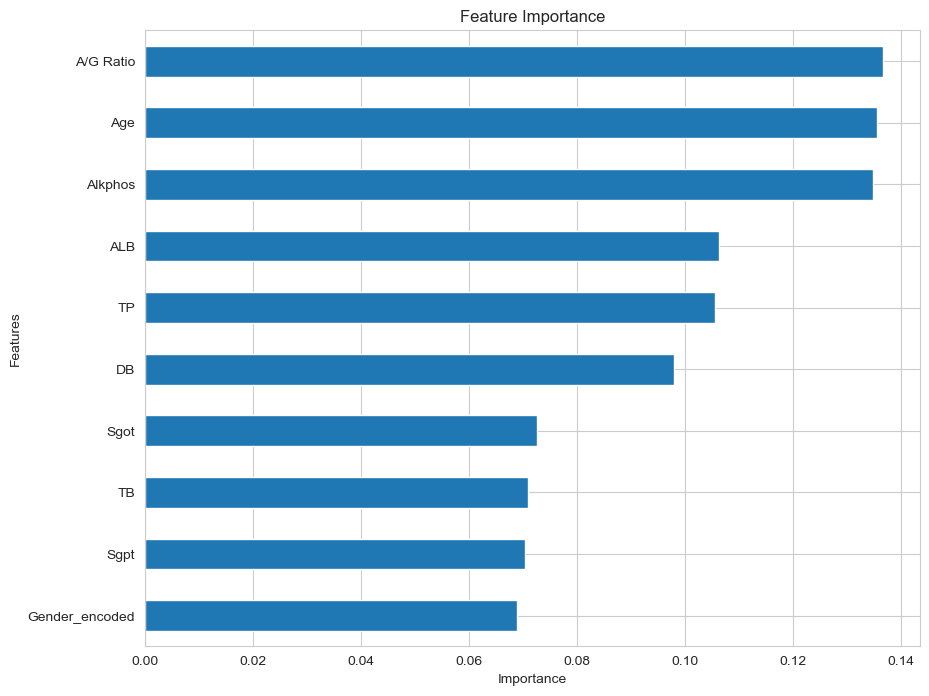

In [49]:
# Plot the feature importances
plt.figure(figsize=(10, 8))
importances.sort_values().plot(kind='barh')
plt.title('Feature Importance')
plt.xlabel('Importance')
plt.ylabel('Features')
plt.show()

AUC 0.96201324769169


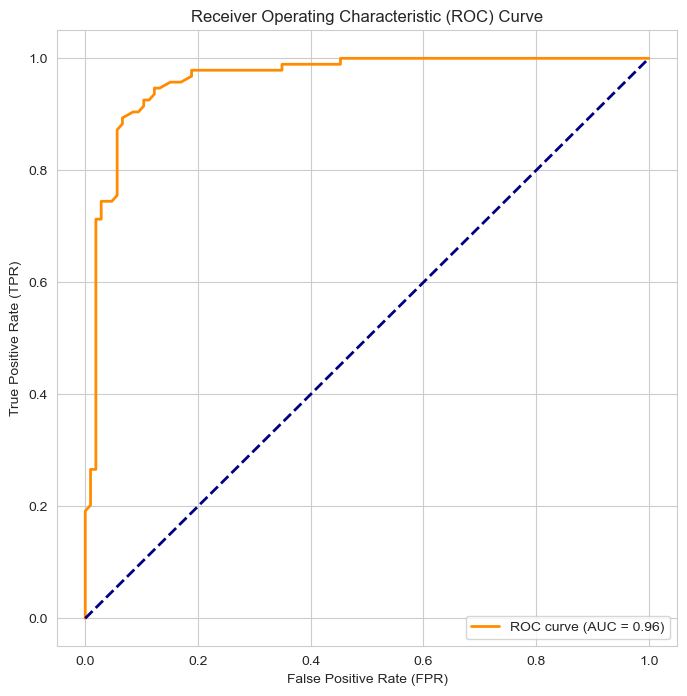

In [50]:
# Calculate ROC curve and AUC
fpr_et, tpr_et, thresholds_et = roc_curve(y_test, y_prob)
auc_et = auc(fpr_et, tpr_et)


print('AUC',auc_et)
# Display ROC curve
plt.figure(figsize=(8, 8))
plt.plot(fpr_et, tpr_et, color='darkorange', lw=2, label=f'ROC curve (AUC = {roc_auc_et:.2f})')
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlabel('False Positive Rate (FPR)')
plt.ylabel('True Positive Rate (TPR)')
plt.title('Receiver Operating Characteristic (ROC) Curve')
plt.legend(loc='lower right')
plt.show()


### Bayesian Optimized ExtraTrees Classifier

In [51]:
import numpy as np
import pandas as pd
from sklearn.datasets import make_classification
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.ensemble import ExtraTreesClassifier
from sklearn.metrics import accuracy_score, roc_auc_score
from bayes_opt import BayesianOptimization

# Generate a synthetic dataset
X, y = make_classification(n_samples=1000, n_features=7, n_informative=5, n_redundant=2, random_state=42)

# Split the dataset into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Initialize and fit StandardScaler
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Apply PCA for dimensionality reduction
pca = PCA(n_components=0.95)
X_train_pca = pca.fit_transform(X_train_scaled)
X_test_pca = pca.transform(X_test_scaled)

# Define the range of hyperparameters to tune
pbounds = {
    'n_estimators': (100, 1000),
    'max_depth': (5, 50),
    'min_samples_split': (2, 10),
    'min_samples_leaf': (1, 5),
    'max_features': (0.1, 0.999)  # Fraction of features to consider at every split
}

# Objective function to optimize
def etc_optimization(n_estimators, max_depth, min_samples_split, min_samples_leaf, max_features):
    params = {
        'n_estimators': int(n_estimators),
        'max_depth': int(max_depth),
        'min_samples_split': int(min_samples_split),
        'min_samples_leaf': int(min_samples_leaf),
        'max_features': max_features
    }
    etc = ExtraTreesClassifier(**params, random_state=42)
    etc.fit(X_train_pca, y_train)
    y_pred = etc.predict_proba(X_test_pca)[:, 1]  # Use predict_proba to compute ROC AUC
    return roc_auc_score(y_test, y_pred)  # Objective: maximize ROC AUC

# Initialize Bayesian Optimization
optimizer = BayesianOptimization(
    f=etc_optimization,
    pbounds=pbounds,
    random_state=42,
)

# Perform optimization
optimizer.maximize(
    init_points=5,  # Number of random configurations to try before the optimization process
    n_iter=25,  # Number of iterations to perform
)

# Best parameters found
print("Best parameters found: ", optimizer.max['params'])

# Train the model using the best parameters
best_params = optimizer.max['params']
best_params['n_estimators'] = int(best_params['n_estimators'])
best_params['max_depth'] = int(best_params['max_depth'])
best_params['min_samples_split'] = int(best_params['min_samples_split'])
best_params['min_samples_leaf'] = int(best_params['min_samples_leaf'])

best_model = ExtraTreesClassifier(**best_params, random_state=42)
best_model.fit(X_train_pca, y_train)

# Evaluate the best model
y_pred = best_model.predict(X_test_pca)
y_prob = best_model.predict_proba(X_test_pca)[:, 1]
roc_auc = roc_auc_score(y_test, y_prob)



# Calculating metrics
accuracy_boet = accuracy_score(y_test, y_pred)
precision_boet = precision_score(y_test, y_pred)
recall_boet = recall_score(y_test, y_pred)
f1_boet = f1_score(y_test, y_pred)
roc_auc_boet = roc_auc_score(y_test, y_prob)

# Calculate ROC curve and AUC
fpr_boet, tpr_boet, thresholds_boet = roc_curve(y_test, y_prob)
auc_boet = auc(fpr_boet, tpr_boet)

# remove duplicate scores_df entries for 'SM_LGBM'
scores_df = scores_df[scores_df['Model'] != 'Bayesian Opt ExtraTrees']
scores_df, temp_df_model = evaluate_model(accuracy_boet, precision_boet, recall_boet, f1_boet, roc_auc_boet, model_name="Bayesian Opt ExtraTrees", scores_df=scores_df)




# Displaying final metrics
print("Final Metrics:")
print("Accuracy:", accuracy_boet)
print("Precision:", precision_boet)
print("Recall:", recall_boet)
print("F1 Score:", f1_boet)
print("ROC AUC:", roc_auc_boet)



|   iter    |  target   | max_depth | max_fe... | min_sa... | min_sa... | n_esti... |
-------------------------------------------------------------------------------------
| 1         | 0.9901    | 21.85     | 0.9547    | 3.928     | 6.789     | 240.4     |
| 2         | 0.969     | 12.02     | 0.1522    | 4.465     | 6.809     | 737.3     |
| 3         | 0.962     | 5.926     | 0.9719    | 4.33      | 3.699     | 263.6     |
| 4         | 0.9732    | 13.25     | 0.3735    | 3.099     | 5.456     | 362.1     |
| 5         | 0.9825    | 32.53     | 0.2254    | 2.169     | 4.931     | 510.5     |
| 6         | 0.9915    | 21.5      | 0.8697    | 3.614     | 7.03      | 241.3     |
| 7         | 0.9917    | 28.07     | 0.7444    | 2.472     | 5.289     | 247.8     |
| 8         | 0.9885    | 42.15     | 0.1       | 1.0       | 10.0      | 246.2     |
| 9         | 0.9716    | 40.51     | 0.2095    | 4.657     | 9.104     | 262.1     |
| 10        | 0.9921    | 39.05     | 0.1       | 1.0 

In [52]:
scores_df.head(15)


,Model,Accuracy,Precision,Recall,F1 Score,ROC-AUC
0,RandomForest,0.803419,0.820000,0.942529,0.877005,0.790421
1,GradientBoosting,0.726496,0.783505,0.873563,0.826087,0.762835
2,RandomizedSearchCV_GradientBoosting,0.683761,0.828947,0.724138,0.773006,0.745594
3,XGBoost_SMOTE,0.692308,0.822785,0.747126,0.783133,0.778927
4,Bayesian_Optimization_XGB,0.743590,0.743590,1.000000,0.852941,0.500000
5,hyperparameter_cv_XGBoost,0.726496,0.816092,0.816092,0.816092,0.755556
6,LightGBM_with_SMOTE,0.675214,0.845070,0.689655,0.759494,0.720307
7,Bayesian_Optimization_LightGBM,0.683761,0.847222,0.701149,0.767296,0.759770
8,LogisticRegression,0.752137,0.784314,0.919540,0.846561,0.819923
9,Bayesian_Optim_hyperparameter_logistic_regression,0.845000,0.895833,0.803738,0.847291,0.903728


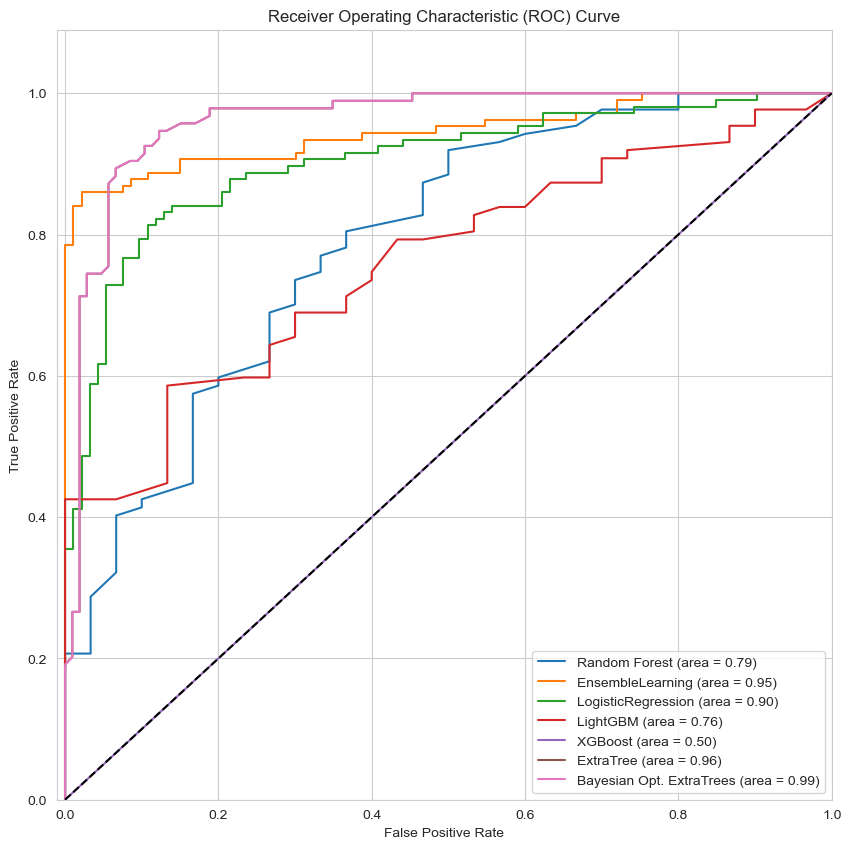

In [53]:
plt.figure(figsize=(10, 10))
plt.plot(fpr_rf, tpr_rf, label='Random Forest (area = %0.2f)' % roc_auc_rf)
plt.plot(fpr_enl, tpr_enl, label='EnsembleLearning (area = %0.2f)' % roc_auc_enl)
plt.plot(fpr_hylr, tpr_hylr, label='LogisticRegression (area = %0.2f)' % roc_auc_hylr)
plt.plot(fpr_lgbm, tpr_lgbm, label='LightGBM (area = %0.2f)' % roc_auc_lgbm)
plt.plot(fpr_boxg, tpr_boxg, label='XGBoost (area = %0.2f)' % roc_auc_boxg)
plt.plot(fpr_et, tpr_et, label='ExtraTree (area = %0.2f)' % roc_auc_et)
plt.plot(fpr_et, tpr_et, label='Bayesian Opt. ExtraTrees (area = %0.2f)' % roc_auc_boet)

plt.plot([0, 1], [0, 1], 'k--')  # random predictions curve
plt.xlim([-0.011, 1.0])
plt.ylim([0.0, 1.09])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve')
plt.legend(loc="lower right")
plt.show()

In [54]:
final_score=scores_df[(scores_df['Accuracy']>=0.74) & (scores_df['Model']!='hyperparameter_cv_XGBoost') ]
final_score.head(10)

,Model,Accuracy,Precision,Recall,F1 Score,ROC-AUC
0,RandomForest,0.803419,0.820000,0.942529,0.877005,0.790421
4,Bayesian_Optimization_XGB,0.743590,0.743590,1.000000,0.852941,0.500000
8,LogisticRegression,0.752137,0.784314,0.919540,0.846561,0.819923
9,Bayesian_Optim_hyperparameter_logistic_regression,0.845000,0.895833,0.803738,0.847291,0.903728
10,EnsembleLearning,0.890000,0.929293,0.859813,0.893204,0.945031
11,ExtraTrees,0.910000,0.872549,0.946809,0.908163,0.962013
12,Bayesian Opt ExtraTrees,0.970000,0.981132,0.962963,0.971963,0.994968


In [55]:
final_score

,Model,Accuracy,Precision,Recall,F1 Score,ROC-AUC
0,RandomForest,0.803419,0.820000,0.942529,0.877005,0.790421
4,Bayesian_Optimization_XGB,0.743590,0.743590,1.000000,0.852941,0.500000
8,LogisticRegression,0.752137,0.784314,0.919540,0.846561,0.819923
9,Bayesian_Optim_hyperparameter_logistic_regression,0.845000,0.895833,0.803738,0.847291,0.903728
10,EnsembleLearning,0.890000,0.929293,0.859813,0.893204,0.945031
11,ExtraTrees,0.910000,0.872549,0.946809,0.908163,0.962013
12,Bayesian Opt ExtraTrees,0.970000,0.981132,0.962963,0.971963,0.994968


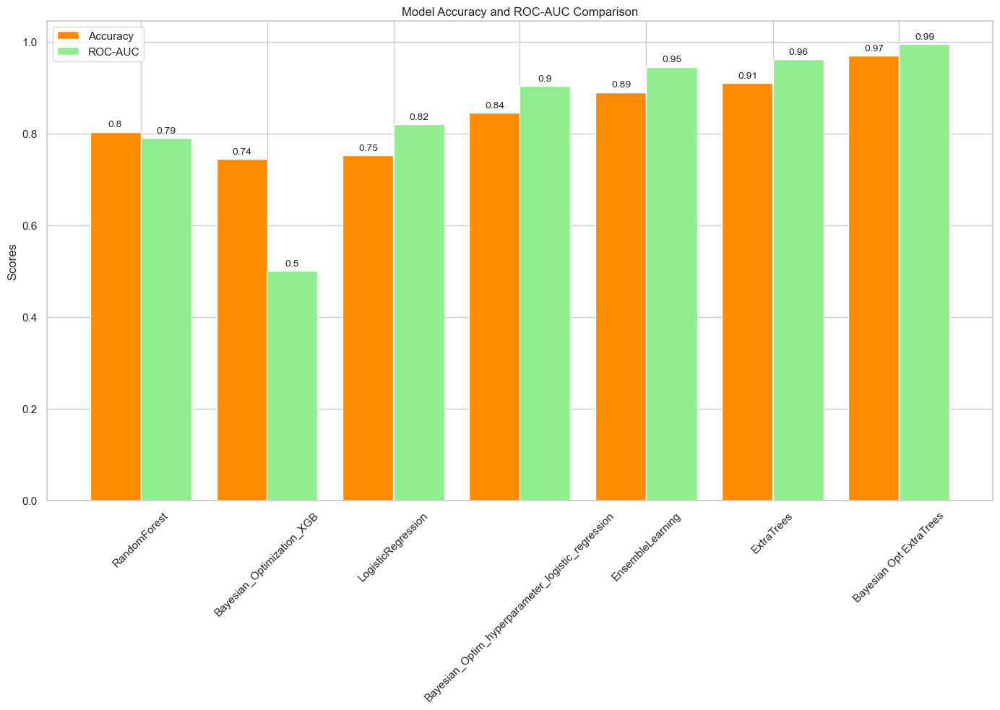

[CV] END etc__max_depth=None, etc__min_samples_leaf=1, etc__min_samples_split=2, etc__n_estimators=50; total time=   0.1s
[CV] END etc__max_depth=None, etc__min_samples_leaf=1, etc__min_samples_split=2, etc__n_estimators=200; total time=   0.2s
[CV] END etc__max_depth=None, etc__min_samples_leaf=2, etc__min_samples_split=2, etc__n_estimators=50; total time=   0.1s
[CV] END etc__max_depth=None, etc__min_samples_leaf=2, etc__min_samples_split=2, etc__n_estimators=100; total time=   0.1s
[CV] END etc__max_depth=None, etc__min_samples_leaf=2, etc__min_samples_split=4, etc__n_estimators=50; total time=   0.0s
[CV] END etc__max_depth=None, etc__min_samples_leaf=2, etc__min_samples_split=4, etc__n_estimators=100; total time=   0.1s
[CV] END etc__max_depth=None, etc__min_samples_leaf=2, etc__min_samples_split=4, etc__n_estimators=200; total time=   0.2s
[CV] END etc__max_depth=5, etc__min_samples_leaf=1, etc__min_samples_split=4, etc__n_estimators=100; total time=   0.1s
[CV] END etc__max_dept

[CV] END etc__max_depth=None, etc__min_samples_leaf=1, etc__min_samples_split=2, etc__n_estimators=100; total time=   0.1s
[CV] END etc__max_depth=None, etc__min_samples_leaf=1, etc__min_samples_split=4, etc__n_estimators=50; total time=   0.1s
[CV] END etc__max_depth=None, etc__min_samples_leaf=1, etc__min_samples_split=4, etc__n_estimators=100; total time=   0.1s
[CV] END etc__max_depth=None, etc__min_samples_leaf=1, etc__min_samples_split=4, etc__n_estimators=200; total time=   0.2s
[CV] END etc__max_depth=None, etc__min_samples_leaf=2, etc__min_samples_split=4, etc__n_estimators=50; total time=   0.1s
[CV] END etc__max_depth=None, etc__min_samples_leaf=2, etc__min_samples_split=4, etc__n_estimators=100; total time=   0.1s
[CV] END etc__max_depth=5, etc__min_samples_leaf=1, etc__min_samples_split=2, etc__n_estimators=50; total time=   0.0s
[CV] END etc__max_depth=5, etc__min_samples_leaf=1, etc__min_samples_split=2, etc__n_estimators=100; total time=   0.1s
[CV] END etc__max_depth=5

[CV] END etc__max_depth=None, etc__min_samples_leaf=1, etc__min_samples_split=2, etc__n_estimators=50; total time=   0.1s
[CV] END etc__max_depth=None, etc__min_samples_leaf=1, etc__min_samples_split=2, etc__n_estimators=200; total time=   0.2s
[CV] END etc__max_depth=None, etc__min_samples_leaf=1, etc__min_samples_split=4, etc__n_estimators=200; total time=   0.2s
[CV] END etc__max_depth=None, etc__min_samples_leaf=2, etc__min_samples_split=2, etc__n_estimators=200; total time=   0.2s
[CV] END etc__max_depth=5, etc__min_samples_leaf=1, etc__min_samples_split=2, etc__n_estimators=50; total time=   0.0s
[CV] END etc__max_depth=5, etc__min_samples_leaf=1, etc__min_samples_split=2, etc__n_estimators=100; total time=   0.1s
[CV] END etc__max_depth=5, etc__min_samples_leaf=1, etc__min_samples_split=4, etc__n_estimators=50; total time=   0.0s
[CV] END etc__max_depth=5, etc__min_samples_leaf=1, etc__min_samples_split=4, etc__n_estimators=50; total time=   0.0s
[CV] END etc__max_depth=5, etc__

In [58]:

import matplotlib.pyplot as plt
import numpy as np

# Assuming 'final_score' DataFrame has columns: 'Model', 'Accuracy', 'ROC-AUC'
# Create a new figure with a specific size
fig, ax = plt.subplots(figsize=(14, 10))

# Set the positions and width for the bars
positions = np.arange(len(final_score['Model']))
width = 0.4

# Plotting both Accuracy and ROC-AUC scores side by side for each model
accuracy_bars = ax.bar(positions - width/2, final_score['Accuracy'], width, label='Accuracy', color='darkorange')
roc_auc_bars = ax.bar(positions + width/2, final_score['ROC-AUC'], width, label='ROC-AUC', color='lightgreen')

# Adding some text for labels, title, and custom x-axis tick labels, etc.
ax.set_ylabel('Scores')
ax.set_title('Model Accuracy and ROC-AUC Comparison')
ax.set_xticks(positions)
ax.set_xticklabels(final_score['Model'])
ax.legend()

# Rotate the x-axis labels for better readability
plt.xticks(rotation=45)

# Annotate the bars with their values
def annotate_bars(bars):
    for bar in bars:
        height = bar.get_height()
        ax.annotate('{}'.format(round(height, 2)),
                    xy=(bar.get_x() + bar.get_width() / 2, height),
                    xytext=(0, 3),  # 3 points vertical offset
                    textcoords="offset points",
                    ha='center', va='bottom', fontsize=10)

annotate_bars(accuracy_bars)
annotate_bars(roc_auc_bars)

plt.tight_layout()
plt.show()


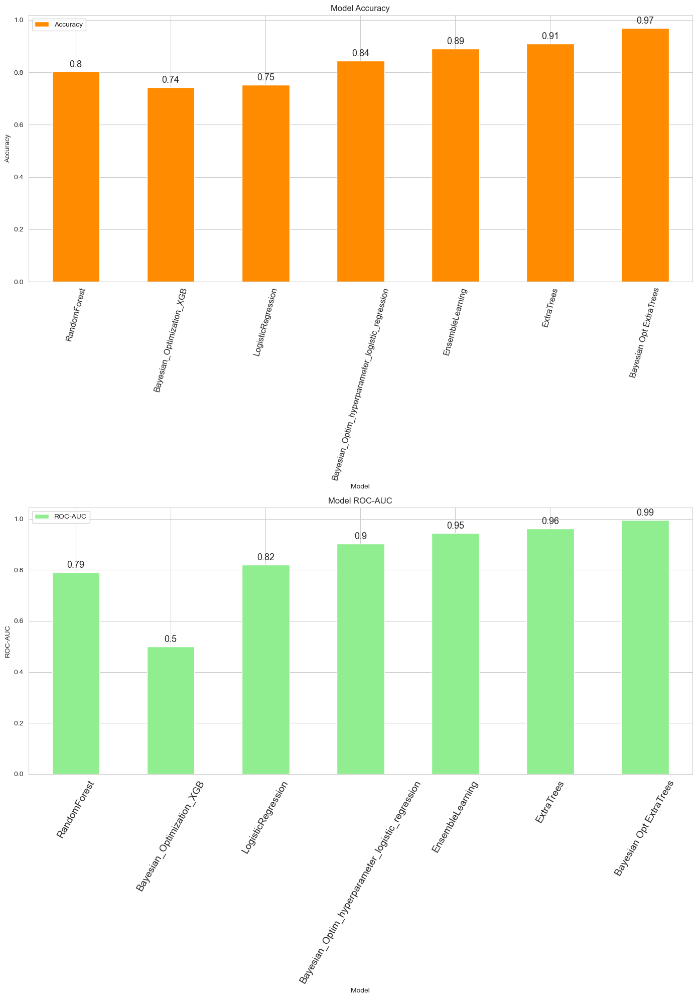

In [56]:
import matplotlib.pyplot as plt

# Plotting Accuracy and ROC-AUC for each model
fig, ax = plt.subplots(2, 1, figsize=(14, 20))
final_score.plot(kind='bar', x='Model', y='Accuracy', ax=ax[0], color='darkorange')
final_score.plot(kind='bar', x='Model', y='ROC-AUC', ax=ax[1], color='lightgreen')
ax[0].set_title('Model Accuracy')
ax[1].set_title('Model ROC-AUC')
ax[0].set_ylabel('Accuracy')
ax[1].set_ylabel('ROC-AUC')

# Increase the font size of x-axis ticks
ax[0].tick_params(axis='x', labelrotation=75, labelsize=12)
ax[1].tick_params(axis='x', labelrotation=60, labelsize=14)

# Annotate the bars with their values
for p in ax[0].patches:
    ax[0].annotate(str(round(p.get_height(), 2)), (p.get_x() + p.get_width() / 2., p.get_height()),
                   ha='center', va='center', xytext=(0, 10), textcoords='offset points', fontsize=13)

for p in ax[1].patches:
    ax[1].annotate(str(round(p.get_height(), 2)), (p.get_x() + p.get_width() / 2., p.get_height()),
                   ha='center', va='center', xytext=(0, 10), textcoords='offset points', fontsize=13)

plt.tight_layout()
plt.show()


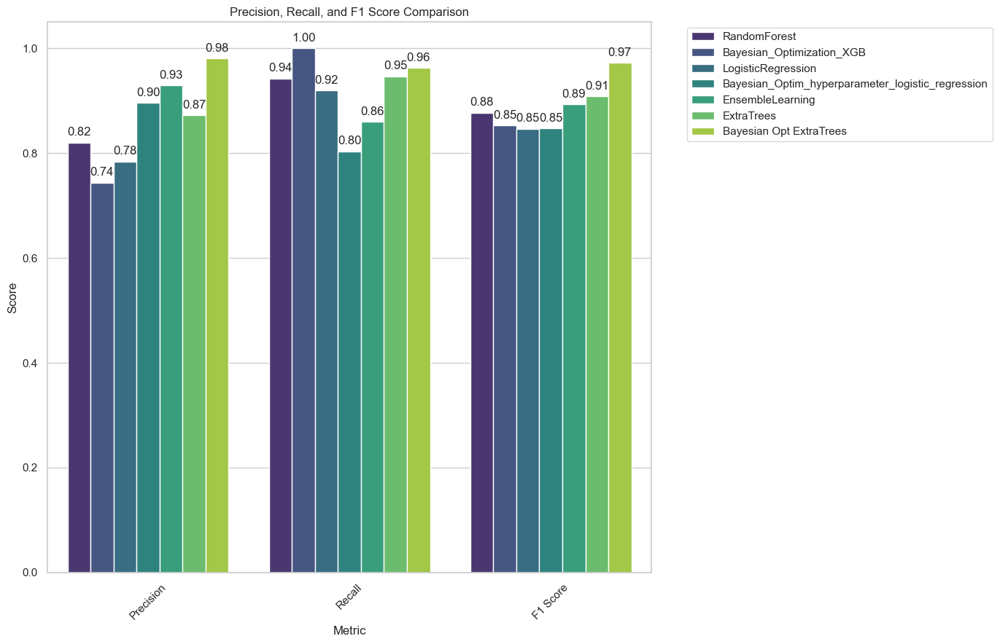

In [57]:
import matplotlib.pyplot as plt
import seaborn as sns

# Melt the DataFrame
df_melted = final_score.melt(id_vars=["Model"], value_vars=["Precision", "Recall", "F1 Score"],
                              var_name="Metric", value_name="Score")

# Set a Seaborn style (optional)
sns.set(style="whitegrid")

# Create the bar plot
plt.figure(figsize=(14, 9))
ax = sns.barplot(x='Metric', y='Score', hue='Model', data=df_melted, palette="viridis")

# Annotate each bar with its value
for p in ax.patches:
    ax.annotate(f'{p.get_height():.2f}', (p.get_x() + p.get_width() / 2., p.get_height()),
                ha='center', va='center', xytext=(0, 10), textcoords='offset points', fontsize=12)

# Add labels and title
plt.title('Precision, Recall, and F1 Score Comparison')
plt.xlabel('Metric')
plt.ylabel('Score')
plt.xticks(rotation=45)

# Move the legend outside the plot for better visibility
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')

# Display the plot
plt.tight_layout()
plt.show()
